# Análisis Exploratorio de Datos

Guillermo Luigui Ubaldo Nieto Angarita

## Guia

https://spotintelligence.com/2023/09/15/exploratory-data-analysis-nlp/

## Diccionario de Datos

## Problema de Investigación

## Planteamiento del problema

## Pregunta de investigación

## Objetivo General

Realizar un análisis exploratorio del corpus periodístico en español proveniente de medios colombianos y mexicanos con el fin de identificar las características lingüísticas, temáticas y estructurales que influyen en la generación de preguntas y respuestas automáticas y en el rendimiento de los modelos de Question Answering (QA) durante su proceso de optimización y fine-tuning.

## Objetivos Específicos

1. Identificar las variedades lingüísticas y diferencias léxicas entre los textos periodísticos de Colombia y México.

    - Propósito: Determinar cómo las diferencias regionales del español (léxico, sintaxis, uso de expresiones y entidades) pueden influir en la comprensión automática de los modelos QA.

    - Técnicas NLP asociadas: tokenización, lematización, análisis morfosintáctico (POS tagging), TF-IDF, y Named Entity Recognition (NER).

2. Analizar las secciones periodísticas y temas predominantes para caracterizar los estilos discursivos presentes en el corpus.

    - Propósito: Explorar cómo las diferencias temáticas y estructurales por sección (Política, Economía, Cultura, Sociedad, etc.) pueden afectar la formulación y tipo de preguntas generables automáticamente.

    - Técnicas NLP asociadas: modelado de tópicos (LDA o BERTopic), análisis de frecuencia de palabras, longitud de textos y complejidad léxica.

3. Analizar las secciones periodísticas y temas predominantes para caracterizar los estilos discursivos presentes en el corpus.

    - Propósito: Explorar cómo las diferencias temáticas y estructurales por sección (Política, Economía, Cultura, Sociedad, etc.) pueden afectar la formulación y tipo de preguntas generables automáticamente.

    - Técnicas NLP asociadas: modelado de tópicos (LDA o BERTopic), análisis de frecuencia de palabras, longitud de textos y complejidad léxica.

4. Identificar patrones de entidades nombradas (NER) relevantes en los textos periodísticos.

    - Propósito: Analizar la presencia y frecuencia de entidades (PERSON, ORG, LOC, DATE, EVENT) por país y sección para detectar potenciales focos de información factual y temas para la generación de preguntas automáticas.

   - Técnicas NLP asociadas: reconocimiento de entidades, conteo de frecuencias y análisis de coocurrencia entre entidades.

4. Determinar qué tipos de preguntas y respuestas pueden generarse automáticamente a partir del análisis lingüístico y semántico del corpus.

    - Propósito: Definir el conjunto de patrones de generación QA (qué, quién, cuándo, dónde, por qué, cómo) que mejor se adapten al dominio periodístico y evaluar su distribución esperada.

    - Técnicas NLP asociadas: análisis semántico, detección de relaciones sujeto-predicado, dependency parsing, y modelos generativos (por ejemplo, T5 o GPT).

## Resultado esperado del EDA

- Identificación de las diferencias lingüísticas y estilísticas entre noticias colombianas y mexicanas.

- Determinación de los tipos de preguntas factuales e inferenciales que pueden generarse automáticamente.

- Hipótesis fundamentada sobre qué modelo y enfoque de fine-tuning podría alcanzar mejor rendimiento en comprensión lectora periodística según país o sección.

## Paso 1: Cargar Librerías

In [1]:
!python -m spacy download es_core_news_lg

     ---------------------------------------- 0.0/568.0 MB ? eta -:--:--
     --------------------------------------- 1.8/568.0 MB 25.4 MB/s eta 0:00:23
     --------------------------------------- 5.5/568.0 MB 19.8 MB/s eta 0:00:29
     --------------------------------------- 6.8/568.0 MB 14.0 MB/s eta 0:00:41
      -------------------------------------- 7.6/568.0 MB 11.5 MB/s eta 0:00:49
      --------------------------------------- 8.4/568.0 MB 9.1 MB/s eta 0:01:02
      --------------------------------------- 9.2/568.0 MB 8.3 MB/s eta 0:01:08
      -------------------------------------- 10.0/568.0 MB 7.5 MB/s eta 0:01:15
      -------------------------------------- 11.3/568.0 MB 7.0 MB/s eta 0:01:19
      -------------------------------------- 11.8/568.0 MB 6.8 MB/s eta 0:01:22
      -------------------------------------- 12.3/568.0 MB 6.4 MB/s eta 0:01:28
      -------------------------------------- 13.1/568.0 MB 5.9 MB/s eta 0:01:34
      -------------------------------------- 13


[notice] A new release of pip is available: 25.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [117]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import re
import os
import string
import spacy
import math
import networkx as nx
import unicodedata
import unidecode


from nltk.tokenize import word_tokenize, sent_tokenize
from nltk.corpus import stopwords
from nltk.util import ngrams
from collections import Counter
from wordcloud import WordCloud
from itertools import combinations
from scipy import stats
from collections import defaultdict
from flair.data import Sentence
from flair.models import SequenceTagger
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
from transformers import pipeline
from textstat import textstat
import hide_code

In [3]:
nltk.download('stopwords')
spanish_stopwords = stopwords.words('spanish')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\guill\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Paso 2: Cargar Datos

In [4]:
df = pd.read_excel("../datasets/exploration_datasets/silver/silver_df_news.xlsx")

In [5]:
df = pd.read_json("../datasets/exploration_datasets/silver/silver_df_news.json", lines=True)

In [6]:
df.head()

,title,category,content,country,newspaper,content_unicode,content_removed_unwanted_elements,content_lowercase,content_sentence_tokenization,content_lowercase_with_no_punctuation,content_without_stopwords,content_tokens,content_lemmes
0,Hamás pide un intercambio “inmediato” de rehen...,internacional,Israel continúa con intensos bombardeos en con...,Mexico,Animal Politico,Israel continúa con intensos bombardeos en co...,Israel continua con intensos bombardeos en con...,israel continua con intensos bombardeos en con...,[israel continua con intensos bombardeos en co...,israel continua con intensos bombardeos en con...,israel continua intensos bombardeos civiles fr...,israel continua intensos bombardeos civiles fr...,"[israel, continuo, intenso, bombardeo, civil, ..."
1,"Ali Akbar, el último vendedor de periódicos am...",internacional,"""¡Mientras tenga energía, seguiré, trabajaré h...",Mexico,Animal Politico,"""¡Mientras tenga energía, seguiré, trabajare...","""¡Mientras tenga energia, seguire, trabajare h...","""¡mientras tenga energia, seguire, trabajare h...","[""¡mientras tenga energia, seguire, trabajare ...",¡mientras tenga energia seguire trabajare hast...,¡ energia seguire trabajare muerte bromea vend...,¡ energia seguire trabajare muerte bromea vend...,"[energia, seguire, trabajare, muerte, bromear,..."
2,Cancillería revisa rutas para el “retorno segu...,internacional,La Embajada de México en Israel se mantiene en...,Mexico,Animal Politico,La Embajada de México en Israel se mantiene e...,La Embajada de Mexico en Israel se mantiene en...,la embajada de mexico en israel se mantiene en...,[la embajada de mexico en israel se mantiene e...,la embajada de mexico en israel se mantiene en...,embajada mexico israel mantiene contacto autor...,embajada mexico israel mantiene contacto autor...,"[embajada, mexico, israel, mantener, contacto,..."
3,"“Nos trataron como animales”, activistas depor...",internacional,Israel detuvo a más de 400 personas y deportó ...,Mexico,Animal Politico,Israel detuvo a más de 400 personas y deporto...,Israel detuvo a mas de 400 personas y deporto ...,israel detuvo a mas de 400 personas y deporto ...,[israel detuvo a mas de 400 personas y deporto...,israel detuvo a mas de 400 personas y deporto ...,israel detuvo 400 personas deporto detenidos v...,israel detuvo 400 personas deporto detenidos v...,"[israel, detener, persona, deporto, detenido, ..."
4,“Estamos más cerca que nunca de una paz durade...,internacional,"La propuesta de paz de Trump contempla, entre ...",Mexico,Animal Politico,"La propuesta de paz de Trump contempla, entre ...","La propuesta de paz de Trump contempla, entre ...","la propuesta de paz de trump contempla, entre ...","[la propuesta de paz de trump contempla, entre...",la propuesta de paz de trump contempla entre o...,propuesta paz trump contempla puntos alto fueg...,propuesta paz trump contempla puntos alto fueg...,"[propuesta, paz, trump, contemplar, punto, alt..."


In [7]:
df.tail()

,title,category,content,country,newspaper,content_unicode,content_removed_unwanted_elements,content_lowercase,content_sentence_tokenization,content_lowercase_with_no_punctuation,content_without_stopwords,content_tokens,content_lemmes
5630,Aumenta a 31 cifra de muertos tras masacre en ...,seguridad,Guayaquil.- La cifra de reclusos muertos en la...,Mexico,El Universal,Guayaquil.- La cifra de reclusos muertos en la...,Guayaquil.- La cifra de reclusos muertos en la...,guayaquil.- la cifra de reclusos muertos en la...,[guayaquil.- la cifra de reclusos muertos en l...,guayaquil la cifra de reclusos muertos en la p...,guayaquil cifra reclusos muertos penitenciaria...,guayaquil cifra reclusos muertos penitenciaria...,"[guayaquil, cifra, recluso, muerto, penitencia..."
5631,"Cataluña, clave para definir quién será el pre...",politica,El desenlace de las elecciones generales del d...,Mexico,El Universal,El desenlace de las elecciones generales del d...,El desenlace de las elecciones generales del d...,el desenlace de las elecciones generales del d...,[el desenlace de las elecciones generales del ...,el desenlace de las elecciones generales del d...,desenlace elecciones generales domingo espana ...,desenlace elecciones generales domingo espana ...,"[desenlacir, elección, general, domingo, espán..."
5632,Migrantes mexicanos caen del muro fronterizo e...,salud,Los Ángeles.- La Oficina de Aduanas y Protecci...,Mexico,El Universal,Los Ángeles.- La Oficina de Aduanas y Protecc...,Los Angeles.- La Oficina de Aduanas y Protecci...,los angeles.- la oficina de aduanas y protecci...,[los angeles.- la oficina de aduanas y protecc...,los angeles la oficina de aduanas y proteccion...,angeles oficina aduanas proteccion fronteriza ...,angeles oficina aduanas proteccion fronteriza ...,"[angel, oficina, aduanas, proteccion, fronteri..."
5633,Gobernador de Oaxaca censura a la prensa; fue ...,politica,El gobernador de Oaxaca y presidente de la Con...,Mexico,El Universal,El gobernador de Oaxaca y presidente de la Con...,El gobernador de Oaxaca y presidente de la Con...,el gobernador de oaxaca y presidente de la con...,[el gobernador de oaxaca y presidente de la co...,el gobernador de oaxaca y presidente de la con...,gobernador oaxaca presidente conferencia nacio...,gobernador oaxaca presidente conferencia nacio...,"[gobernador, oaxaco, presidente, conferencia, ..."
5634,Desabasto y desaparición de las NOMs,salud,Irene Tello Arista\nCuando decidimos en Impuni...,Mexico,El Universal,Irene Tello Arista\nCuando decidimos en Impuni...,Irene Tello Arista Cuando decidimos en Impunid...,irene tello arista cuando decidimos en impunid...,[irene tello arista cuando decidimos en impuni...,irene tello arista cuando decidimos en impunid...,irene tello arista decidimos impunidad cero ju...,irene tello arista decidimos impunidad cero ju...,"[irenir, tello, arista, decidir, impunidad, ce..."


## Paso 3: Identificar las variedades lingüísticas por ubicación geográfica, prensa escrita y tipo de sección

### Paso 3.1: Distribución y estructura general

Analizar la composición del corpus por país, periódico y sección para entender el equilibrio de los datos y la representatividad de cada fuente.

#### Paso 3.1.1: ¿Cuántas noticias hay por país (Colombia vs. México)?

In [8]:
df['country'].value_counts()

country
Colombia    3980
Mexico      1655
Name: count, dtype: int64

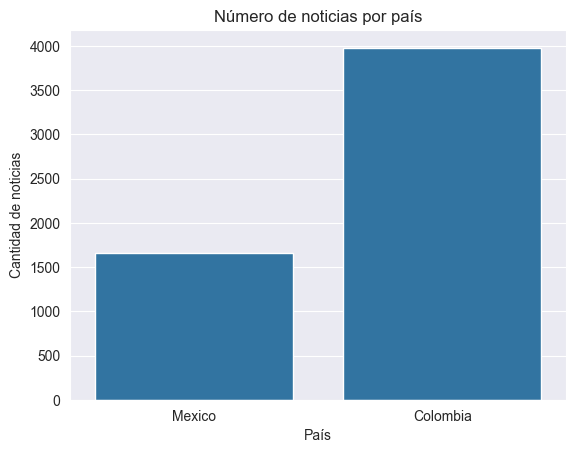

In [9]:
sns.countplot(data=df, x='country')
plt.title("Número de noticias por país")
plt.xlabel("País")
plt.ylabel("Cantidad de noticias")
plt.show()

#### Paso 3.1.2: ¿Cuáles son los periódicos con mayor número de textos en cada país?

In [10]:
df.groupby(['country', 'newspaper']).size().reset_index(name='num_texts').sort_values(['country', 'num_texts'], ascending=[True, False])


,country,newspaper,num_texts
3,Colombia,Semana,1610
1,Colombia,La El Colombiano,1083
2,Colombia,La El Espectador,767
0,Colombia,El Tiempo,520
5,Mexico,El Excelsior,656
4,Mexico,Animal Politico,574
7,Mexico,La Jornada,392
6,Mexico,El Universal,33


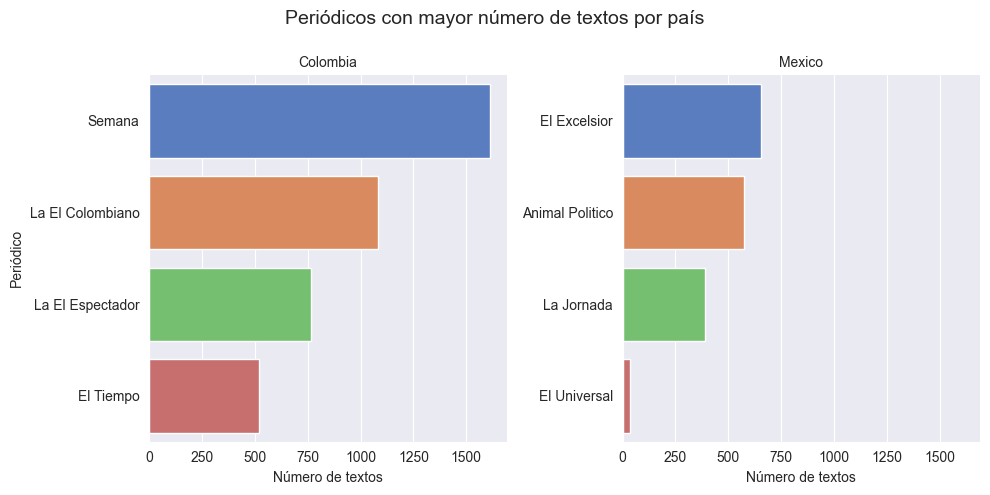

In [11]:
# --- Agrupar los datos: número de textos por periódico y país ---
newspaper_counts = (
    df.groupby(['country', 'newspaper'])
      .size()
      .reset_index(name='num_texts')
)

# --- Ordenar de mayor a menor dentro de cada país ---
newspaper_counts = newspaper_counts.sort_values(['country', 'num_texts'], ascending=[True, False])

# --- Crear gráfico por país con el mismo eje X ---
g = sns.FacetGrid(
    newspaper_counts,
    col='country',
    sharex=True,   # 👉 mantiene el mismo rango del eje X
    sharey=False,
    height=5,
    aspect=1
)

g.map_dataframe(
    sns.barplot,
    x='num_texts',
    y='newspaper',
    hue='newspaper',       # ✅ añade hue
    palette='muted',       # ✅ ahora es válido
    legend=False           # ✅ evita mostrar la leyenda
)

# --- Personalización del gráfico ---
g.set_titles(col_template='{col_name}')
g.set_axis_labels('Número de textos', 'Periódico')
g.fig.subplots_adjust(top=0.85)
g.fig.suptitle('Periódicos con mayor número de textos por país', fontsize=14)

# --- Mostrar gráfico ---
plt.show()

#### Paso 3.1.3: ¿Qué proporción de textos hay por tipo de sección?

In [12]:
df['category'].value_counts(normalize=True)

category
cultura          0.231588
politica         0.224135
economica        0.214729
internacional    0.178350
salud            0.107010
judicial         0.036912
seguridad        0.007276
Name: proportion, dtype: float64

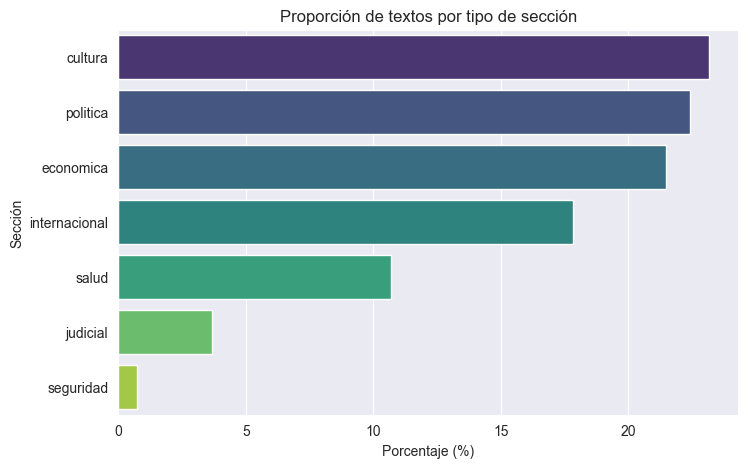

In [13]:
category_counts = df['category'].value_counts(normalize=True).reset_index()
category_counts.columns = ['category', 'percentage']
category_counts['percentage'] *= 100

plt.figure(figsize=(8,5))
sns.barplot(
    data=category_counts,
    x='percentage',
    y='category',
    hue='category',
    palette='viridis',
    legend=False
)
plt.title('Proporción de textos por tipo de sección')
plt.xlabel('Porcentaje (%)')
plt.ylabel('Sección')
plt.show()

#### Paso 3.1.4: ¿Qué longitud promedio tienen los textos (en palabras o oraciones) por país, periódico y sección?

In [14]:
df["num_sentences"] = df["content_sentence_tokenization"].apply(len)
df["num_words"] = df["content_tokens"].apply(lambda x: len(x.split()))

In [15]:
df["content_tokens"]

0       israel continua intensos bombardeos civiles fr...
1       ¡ energia seguire trabajare muerte bromea vend...
2       embajada mexico israel mantiene contacto autor...
3       israel detuvo 400 personas deporto detenidos v...
4       propuesta paz trump contempla puntos alto fueg...
                              ...                        
5630    guayaquil cifra reclusos muertos penitenciaria...
5631    desenlace elecciones generales domingo espana ...
5632    angeles oficina aduanas proteccion fronteriza ...
5633    gobernador oaxaca presidente conferencia nacio...
5634    irene tello arista decidimos impunidad cero ju...
Name: content_tokens, Length: 5635, dtype: object

In [16]:
# Create the grouped dataframe
avg_length = (
    df.groupby(["country", "newspaper", "category"])
    .agg(
        avg_words=("num_words", "mean"),
        avg_sentences=("num_sentences", "mean")
    )
    .reset_index()
)

# Separate and print by country
for country, group in avg_length.groupby("country"):
    print(f"\n=== {country.upper()} ===")
    print(group.sort_values(by="avg_words", ascending=False).to_string(index=False))


=== COLOMBIA ===
 country        newspaper      category  avg_words  avg_sentences
Colombia           Semana       cultura 441.795804      40.593007
Colombia La El Colombiano      politica 364.739583      31.666667
Colombia        El Tiempo     seguridad 358.142857      31.571429
Colombia La El Colombiano     economica 333.381089      30.131805
Colombia La El Colombiano       cultura 323.979798      28.469697
Colombia           Semana         salud 306.918919      24.344595
Colombia La El Colombiano         salud 300.978261      22.880435
Colombia        El Tiempo      politica 297.834862      25.770642
Colombia La El Colombiano internacional 276.839080      21.410920
Colombia        El Tiempo     economica 275.163462      20.817308
Colombia        El Tiempo       cultura 260.064516      24.838710
Colombia           Semana     economica 253.826667      20.244444
Colombia           Semana      politica 251.074074      22.727273
Colombia        El Tiempo         salud 219.403670      18

In [17]:
df[(df["country"] == "Mexico") & (df["category"] == "economica")]["content"].iloc[4]

'Los empresarios del país esperan abrir nuevos mercados en importante feria en Madrid (España) y superar la meta de exportaciones de 2024. . La canasta exportadora de frutas colombianas se presenta con una diversidad que incluye productos tradicionales como el banano, pero también como la piña, el aguacate Hass, la gulupa y los arándanos, entre otras.\nEntre enero y julio de 2025, las exportaciones de frutas frescas colombianas registraron US$1.248 millones, con un aumento de 13,4 % frente al mismo periodo de 2024, de acuerdo con cifras oficiales y el análisis de la Asociación Nacional de Comercio Exterior (Analdex).\nEstados Unidos, Países Bajos, Bélgica, Reino Unido, Alemania e Italia, fueron los destinos que más compraron las frutas colombianas. Allí resalta que EE. UU. tuvo un 27,7 % de participación en el total de estas compras y un aumento de 55,9 %, llegando a US$345,6 millones.'

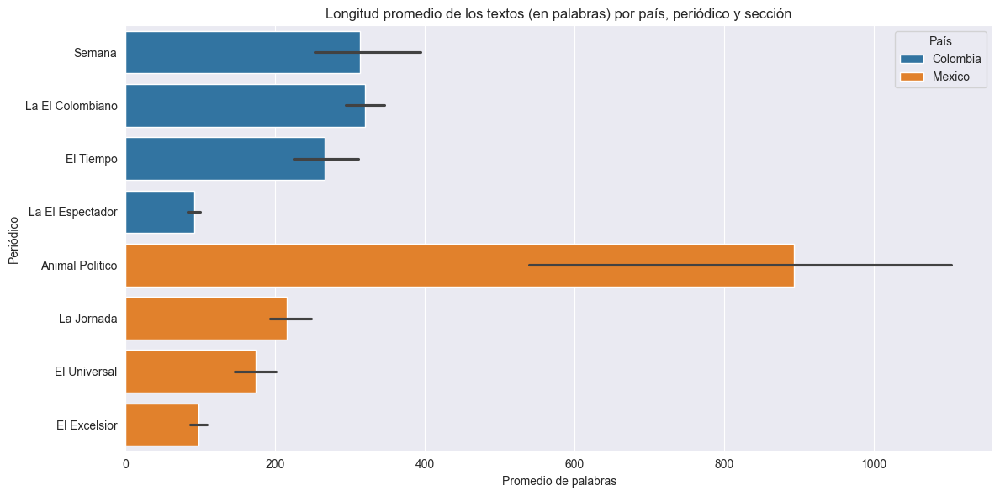

In [18]:
plt.figure(figsize=(12, 6))

# Compute order by country, then by descending avg_words
order = (
    avg_length
    .sort_values(by=["country", "avg_words"], ascending=[True, False])
    .newspaper
    .unique()
)

sns.barplot(
    data=avg_length,
    x="avg_words",
    y="newspaper",
    hue="country",
    order=order
)

plt.title("Longitud promedio de los textos (en palabras) por país, periódico y sección")
plt.xlabel("Promedio de palabras")
plt.ylabel("Periódico")
plt.legend(title="País")
plt.tight_layout()
plt.show()


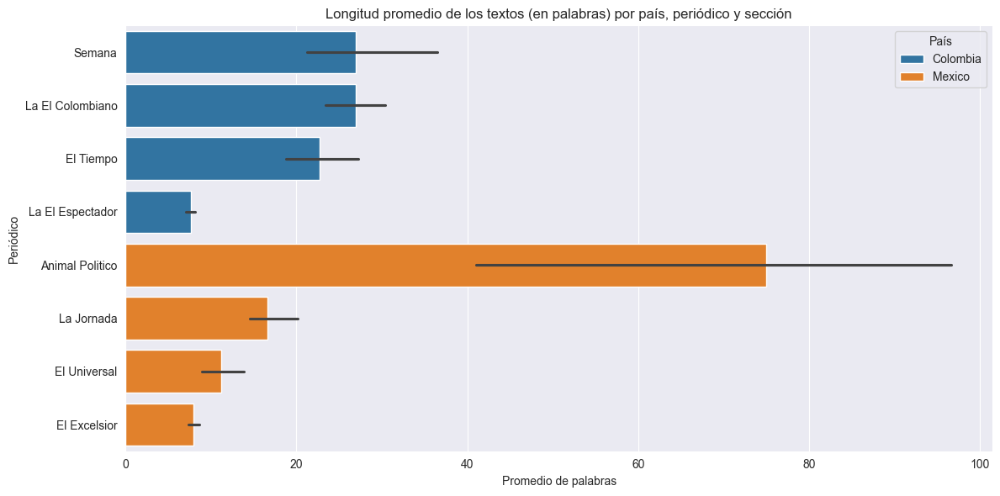

In [19]:
plt.figure(figsize=(12, 6))

# Compute order by country, then by descending avg_words
order = (
    avg_length
    .sort_values(by=["country", "avg_sentences"], ascending=[True, False])
    .newspaper
    .unique()
)

sns.barplot(
    data=avg_length,
    x="avg_sentences",
    y="newspaper",
    hue="country",
    order=order
)

plt.title("Longitud promedio de los textos (en palabras) por país, periódico y sección")
plt.xlabel("Promedio de palabras")
plt.ylabel("Periódico")
plt.legend(title="País")
plt.tight_layout()
plt.show()

### Paso 3.2: Variedades lingüísticas y léxicas

Propósito:
Identificar las diferencias léxicas y expresiones regionales que caracterizan las variedades del español en ambos países y secciones.

#### Paso 3.2.1: ¿Qué palabras son exclusivas o más frecuentes en los textos de Colombia frente a los de México?

In [20]:
df.head()

,title,category,content,country,newspaper,content_unicode,content_removed_unwanted_elements,content_lowercase,content_sentence_tokenization,content_lowercase_with_no_punctuation,content_without_stopwords,content_tokens,content_lemmes,num_sentences,num_words
0,Hamás pide un intercambio “inmediato” de rehen...,internacional,Israel continúa con intensos bombardeos en con...,Mexico,Animal Politico,Israel continúa con intensos bombardeos en co...,Israel continua con intensos bombardeos en con...,israel continua con intensos bombardeos en con...,[israel continua con intensos bombardeos en co...,israel continua con intensos bombardeos en con...,israel continua intensos bombardeos civiles fr...,israel continua intensos bombardeos civiles fr...,"[israel, continuo, intenso, bombardeo, civil, ...",87,988
1,"Ali Akbar, el último vendedor de periódicos am...",internacional,"""¡Mientras tenga energía, seguiré, trabajaré h...",Mexico,Animal Politico,"""¡Mientras tenga energía, seguiré, trabajare...","""¡Mientras tenga energia, seguire, trabajare h...","""¡mientras tenga energia, seguire, trabajare h...","[""¡mientras tenga energia, seguire, trabajare ...",¡mientras tenga energia seguire trabajare hast...,¡ energia seguire trabajare muerte bromea vend...,¡ energia seguire trabajare muerte bromea vend...,"[energia, seguire, trabajare, muerte, bromear,...",146,1549
2,Cancillería revisa rutas para el “retorno segu...,internacional,La Embajada de México en Israel se mantiene en...,Mexico,Animal Politico,La Embajada de México en Israel se mantiene e...,La Embajada de Mexico en Israel se mantiene en...,la embajada de mexico en israel se mantiene en...,[la embajada de mexico en israel se mantiene e...,la embajada de mexico en israel se mantiene en...,embajada mexico israel mantiene contacto autor...,embajada mexico israel mantiene contacto autor...,"[embajada, mexico, israel, mantener, contacto,...",102,1342
3,"“Nos trataron como animales”, activistas depor...",internacional,Israel detuvo a más de 400 personas y deportó ...,Mexico,Animal Politico,Israel detuvo a más de 400 personas y deporto...,Israel detuvo a mas de 400 personas y deporto ...,israel detuvo a mas de 400 personas y deporto ...,[israel detuvo a mas de 400 personas y deporto...,israel detuvo a mas de 400 personas y deporto ...,israel detuvo 400 personas deporto detenidos v...,israel detuvo 400 personas deporto detenidos v...,"[israel, detener, persona, deporto, detenido, ...",114,1292
4,“Estamos más cerca que nunca de una paz durade...,internacional,"La propuesta de paz de Trump contempla, entre ...",Mexico,Animal Politico,"La propuesta de paz de Trump contempla, entre ...","La propuesta de paz de Trump contempla, entre ...","la propuesta de paz de trump contempla, entre ...","[la propuesta de paz de trump contempla, entre...",la propuesta de paz de trump contempla entre o...,propuesta paz trump contempla puntos alto fueg...,propuesta paz trump contempla puntos alto fueg...,"[propuesta, paz, trump, contemplar, punto, alt...",44,510


In [21]:
# Normalize country names
df["country"] = df["country"].str.strip().str.capitalize()
df["country"] = df["country"].replace({"Mexico": "México"})

In [22]:
# Prepare texts by country
corpora = {}
for country in df["country"].unique():
    corpora[country] = [
        " ".join(lemmas) for lemmas in df[df["country"] == country]["content_lemmes"].tolist() if isinstance(lemmas, list)
    ]

In [23]:
# Compute TF-IDF separately for each country
top_words_list = []
for country, texts in corpora.items():
    vectorizer = TfidfVectorizer(stop_words=spanish_stopwords, max_features=10000)
    tfidf = vectorizer.fit_transform(texts)
    tfidf_df = pd.DataFrame(tfidf.toarray(), columns=vectorizer.get_feature_names_out())

    # Average TF-IDF per word
    mean_tfidf = tfidf_df.mean().sort_values(ascending=False).head(10)

    # Save for plotting
    top_words = pd.DataFrame({
        "word": mean_tfidf.index,
        "tfidf": mean_tfidf.values,
        "country": country
    })
    top_words_list.append(top_words)

In [24]:
# Combine results
top_words_df = pd.concat(top_words_list, ignore_index=True)


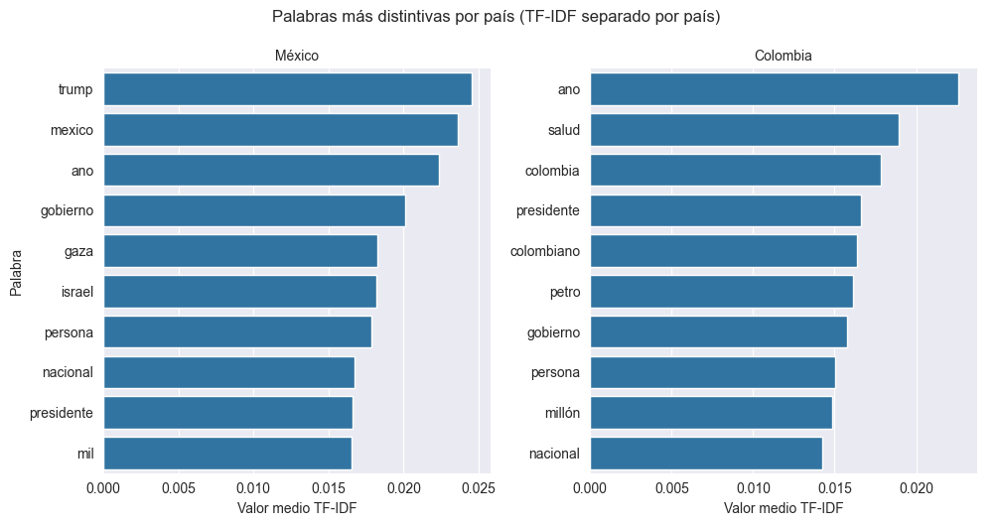

In [25]:
# Plot side-by-side by country
g = sns.catplot(
    data=top_words_df,
    x="tfidf", y="word",
    col="country",
    kind="bar",
    sharex=False, sharey=False,
    col_wrap=2,
    height=5, aspect=1
)
g.set_titles("{col_name}")
g.set_axis_labels("Valor medio TF-IDF", "Palabra")
g.fig.suptitle("Palabras más distintivas por país (TF-IDF separado por país)", y=1.05)
plt.show()

## Por pais y categoria

In [26]:
# Normalize columns
df["country"] = df["country"].str.strip().str.capitalize()
df["country"] = df["country"].replace({"Mexico": "México"})
df["category"] = df["category"].str.strip().str.capitalize()

In [27]:
# Prepare a list to store results
results = []

# Compute TF-IDF per (country, category)
for (country, category), subset in df.groupby(["country", "category"]):
    # Join lemmas into strings
    texts = [
        " ".join(lemmas) for lemmas in subset["content_lemmes"].dropna().tolist() if isinstance(lemmas, list)
    ]

    if len(texts) == 0:
        continue

    # TF-IDF Vectorization
    vectorizer = TfidfVectorizer(stop_words=spanish_stopwords, max_features=10000)
    tfidf = vectorizer.fit_transform(texts)
    tfidf_df = pd.DataFrame(tfidf.toarray(), columns=vectorizer.get_feature_names_out())

    # Average TF-IDF per word
    mean_tfidf = tfidf_df.mean().sort_values(ascending=False).head(10)

    temp = pd.DataFrame({
        "word": mean_tfidf.index,
        "tfidf": mean_tfidf.values,
        "country": country,
        "category": category
    })
    results.append(temp)

In [28]:
# Combine all
top_words_df = pd.concat(results, ignore_index=True)

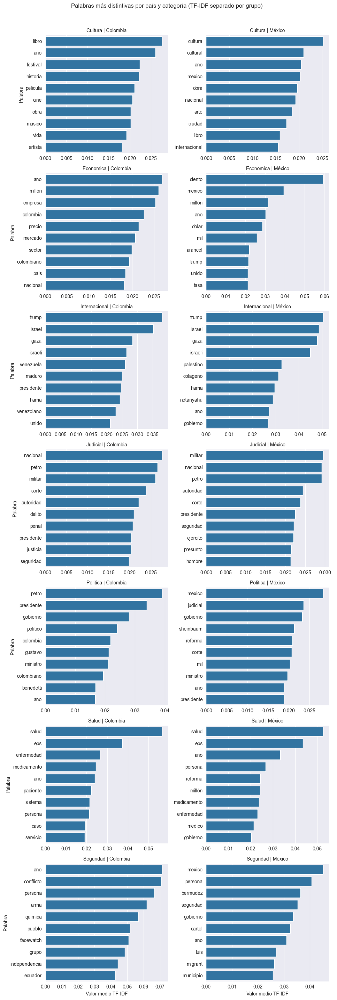

In [29]:
# Plot: each column = country, each row = category
g = sns.catplot(
    data=top_words_df,
    x="tfidf", y="word",
    col="country",
    row="category",
    kind="bar",
    sharex=False, sharey=False,
    height=4, aspect=1.2
)
g.set_titles("{row_name} | {col_name}")
g.set_axis_labels("Valor medio TF-IDF", "Palabra")
g.fig.suptitle("Palabras más distintivas por país y categoría (TF-IDF separado por grupo)", y=1.02)
plt.show()

#### Paso 3.2.2: ¿Existen diferencias en el uso de pronombres, diminutivos o modismos entre ambos países?

##### Análisis de pronombres

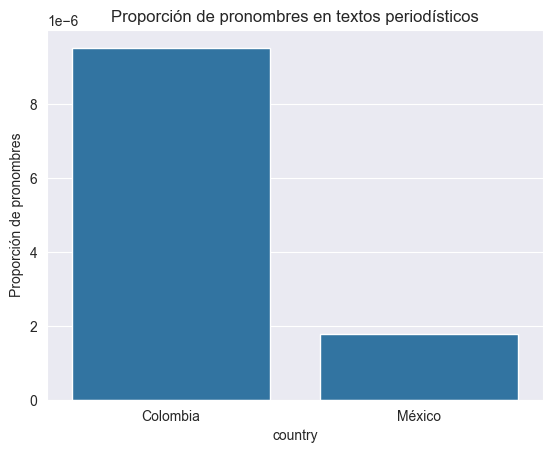

In [30]:
# Lista básica de pronombres en español
pronouns = set([
    "yo", "tú", "vos", "usted", "él", "ella", "nosotros", "nosotras",
    "ustedes", "ellos", "ellas", "me", "te", "se", "nos", "os", "lo",
    "la", "le", "los", "las", "les", "mí", "ti", "sí", "mío", "mía",
    "suyo", "suya", "nuestro", "nuestra", "este", "ese", "aquel", "esto",
    "eso", "aquello"
])

results_pronouns = []

for country, subset in df.groupby("country"):
    tokens = [lemma for text in subset["content_lemmes"].dropna() for lemma in text]
    pronoun_count = sum(1 for w in tokens if w.lower() in pronouns)
    total_tokens = len(tokens)
    results_pronouns.append({
        "country": country,
        "pronoun_ratio": pronoun_count / total_tokens
    })

pronoun_df = pd.DataFrame(results_pronouns)
sns.barplot(data=pronoun_df, x="country", y="pronoun_ratio")
plt.title("Proporción de pronombres en textos periodísticos")
plt.ylabel("Proporción de pronombres")
plt.show()

##### Análisis de diminutivos

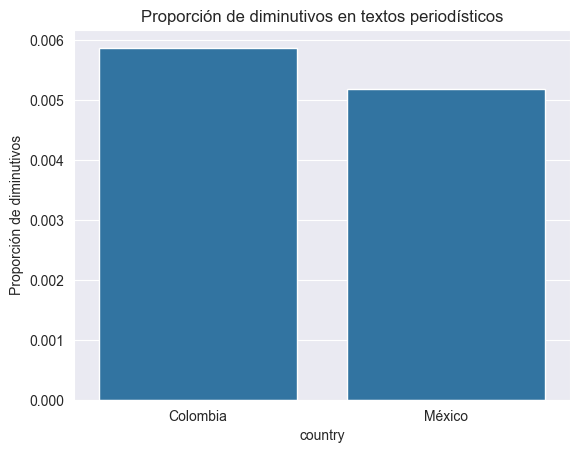

In [31]:
import re

results_diminutives = []

for country, subset in df.groupby("country"):
    tokens = [lemma for text in subset["content_lemmes"].dropna() for lemma in text]
    diminutives = [w for w in tokens if re.search(r"(ito|ita|cito|cita)$", w.lower())]
    results_diminutives.append({
        "country": country,
        "diminutive_ratio": len(diminutives) / len(tokens)
    })

diminutive_df = pd.DataFrame(results_diminutives)
sns.barplot(data=diminutive_df, x="country", y="diminutive_ratio")
plt.title("Proporción de diminutivos en textos periodísticos")
plt.ylabel("Proporción de diminutivos")
plt.show()


##### Análisis de modismos

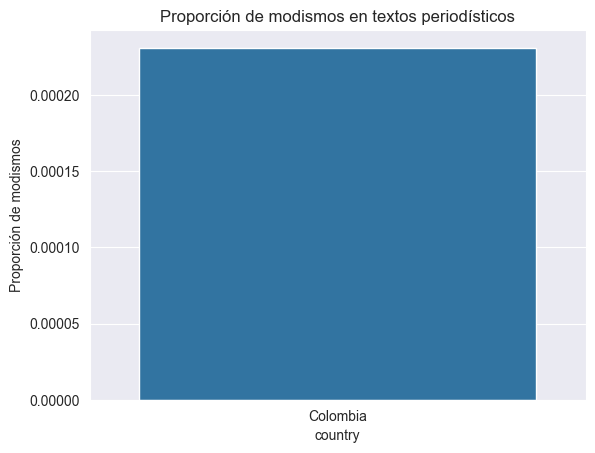

In [32]:
modismos_colombia = {"parche", "pelao", "vaina", "bacano", "chino"}
modismos_mexico = {"chido", "cuate", "lana", "padre", "güey"}

results_modismos = []

for country, subset in df.groupby("country"):
    tokens = [lemma.lower() for text in subset["content_lemmes"].dropna() for lemma in text]
    if country.lower() == "colombia":
        modismos = modismos_colombia
    elif country.lower() == "mexico":
        modismos = modismos_mexico
    else:
        continue

    count_modismos = sum(1 for w in tokens if w in modismos)
    results_modismos.append({
        "country": country,
        "modismo_ratio": count_modismos / len(tokens)
    })

modismo_df = pd.DataFrame(results_modismos)
sns.barplot(data=modismo_df, x="country", y="modismo_ratio")
plt.title("Proporción de modismos en textos periodísticos")
plt.ylabel("Proporción de modismos")
plt.show()

#### Paso 3.2.3: ¿Qué términos o expresiones regionales aparecen con mayor frecuencia por sección?

In [33]:
# Crear una estructura para guardar las palabras más comunes por país y categoría
regional_terms = {}

for country in df["country"].unique():
    regional_terms[country] = {}
    country_df = df[df["country"] == country]

    for category in country_df["category"].unique():
        # Unir todas las listas de lemas de esa categoría
        all_lemmes = sum(country_df[country_df["category"] == category]["content_lemmes"].tolist(), [])

        # Contar frecuencia
        counter = Counter(all_lemmes)

        # Seleccionar las más frecuentes (ajusta n según tu preferencia)
        most_common = counter.most_common(20)

        regional_terms[country][category] = pd.DataFrame(most_common, columns=["term", "frequency"])



In [34]:
regional_terms

{'México': {'Internacional':               term  frequency
  0            trump       2068
  1           israel       1794
  2             gaza       1631
  3              ano       1550
  4          israeli       1514
  5          persona       1261
  6         gobierno       1229
  7              bbc       1182
  8        palestino       1135
  9           guerra       1027
  10          ciudad        999
  11           poder        947
  12           mundo        937
  13            hama        936
  14       netanyahu        877
  15      presidente        821
  16        colageno        819
  17           unido        800
  18         rodilla        769
  19  estadounidense        768,
  'Politica':           term  frequency
  0       mexico        925
  1     gobierno        692
  2    sheinbaum        629
  3     judicial        593
  4          mil        556
  5      reforma        546
  6     nacional        530
  7          ano        521
  8     politico        520
  9     

In [35]:
# Ejemplo: ver los términos más comunes de "Mexico" en la categoría "Economía"
regional_terms["México"]["Economica"].head(10)

,term,frequency
0,ciento,497
1,mexico,338
2,ano,222
3,millón,217
4,mil,180
5,dolar,166
6,unido,160
7,arancel,140
8,trump,139
9,mexicano,138


C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3206556652.py:19: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(10, "frequency"))


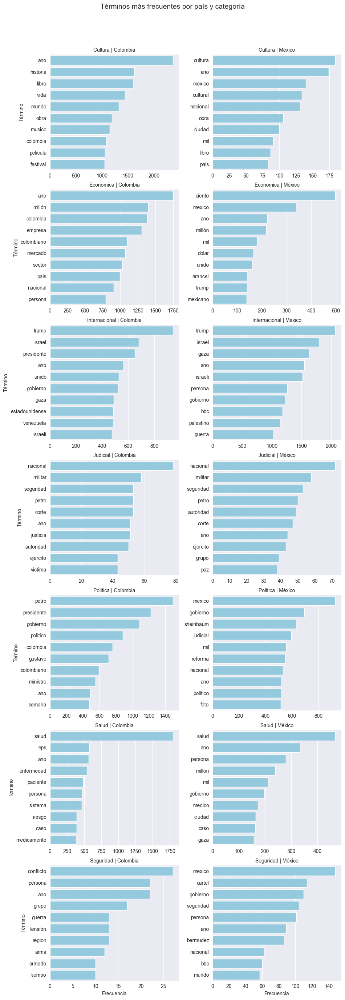

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Combine results into one DataFrame
plot_df_all = []
for country in regional_terms.keys():
    for category in regional_terms[country].keys():
        temp_df = regional_terms[country][category].copy()
        temp_df["country"] = country
        temp_df["category"] = category
        plot_df_all.append(temp_df)

plot_df_all = pd.concat(plot_df_all)

# Keep top 10 most frequent terms per (country, category)
plot_df_all = (
    plot_df_all.groupby(["country", "category"], group_keys=False, observed=True)
    .apply(lambda x: x.nlargest(10, "frequency"))
    .reset_index(drop=True)
)


# Create one grid of plots: columns = countries, rows = categories
g = sns.FacetGrid(
    plot_df_all,
    col="country",
    row="category",
    sharex=False,
    sharey=False,
    height=4,
    aspect=1.2
)

# Add barplots to each facet
g.map_dataframe(
    sns.barplot,
    x="frequency",
    y="term",
    color="skyblue"
)

# Adjust layout and titles
g.set_titles(row_template="{row_name}", col_template="{col_name}")
g.set_axis_labels("Frecuencia", "Término")
plt.subplots_adjust(top=0.93)
g.fig.suptitle("Términos más frecuentes por país y categoría", fontsize=14)
plt.show()

#### Paso 3.2.4: ¿Qué diferencias hay en las palabras más frecuentes por periódico dentro del mismo país?

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3578012932.py:31: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(10, "tfidf"))
C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3578012932.py:56: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend(title="Periódico", fontsize=8)


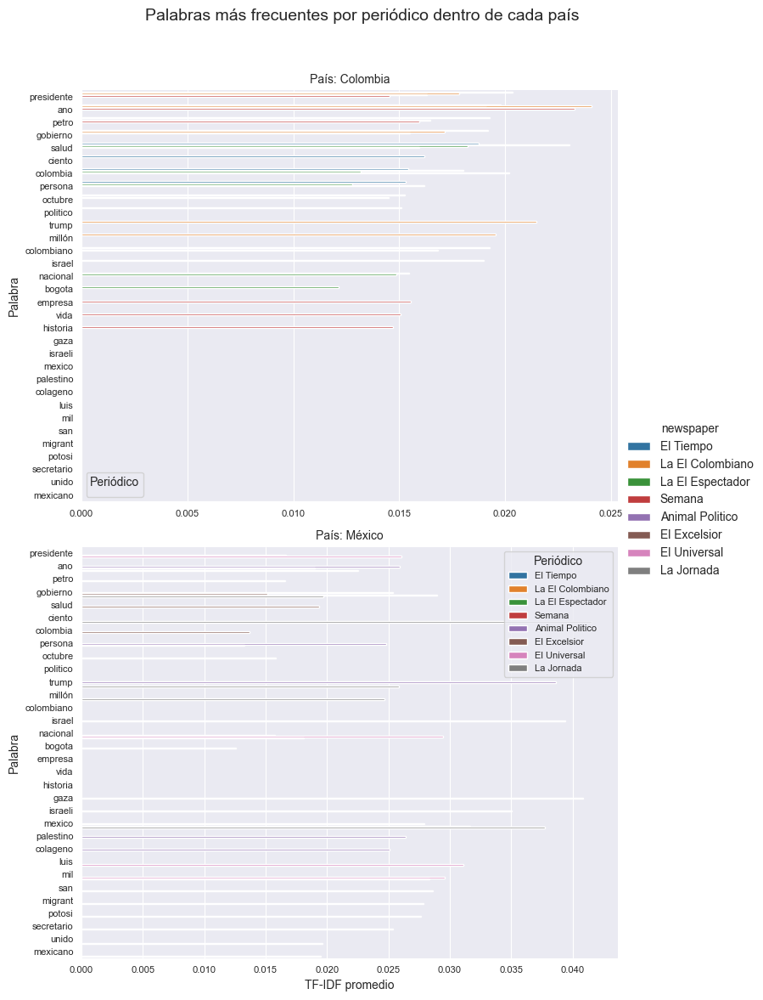

In [37]:
results = []

# Calcular TF-IDF por (país, periódico)
for (country, newspaper), subset in df.groupby(["country", "newspaper"]):
    texts = subset["content_lemmes"].dropna().tolist()
    if len(texts) == 0:
        continue

    # Unir los lemas en cadenas de texto
    texts = [" ".join(t) for t in texts]

    vectorizer = TfidfVectorizer(stop_words=spanish_stopwords, max_features=10000)
    tfidf = vectorizer.fit_transform(texts)
    tfidf_df = pd.DataFrame(tfidf.toarray(), columns=vectorizer.get_feature_names_out())

    mean_tfidf = tfidf_df.mean().sort_values(ascending=False).head(10)

    temp = pd.DataFrame({
        "word": mean_tfidf.index,
        "tfidf": mean_tfidf.values,
        "country": country,
        "newspaper": newspaper
    })
    results.append(temp)

freq_df = pd.concat(results, ignore_index=True)

# Seleccionar las 10 palabras más relevantes por periódico
freq_df_top = (
    freq_df.groupby(["country", "newspaper"], group_keys=False)
    .apply(lambda x: x.nlargest(10, "tfidf"))
    .reset_index(drop=True)
)

# Increase figure size and layout
g = sns.catplot(
    data=freq_df_top,
    x="tfidf", y="word",
    hue="newspaper",
    col="country",
    kind="bar",
    dodge=True,
    sharex=False,
    height=6, aspect=1.3,
    col_wrap=1  # ✅ One country per row for clarity
)

# Improve title and labels
g.set_titles("País: {col_name}")
g.set_axis_labels("TF-IDF promedio", "Palabra")

# Make text smaller and readable
for ax in g.axes.flat:
    ax.tick_params(axis='y', labelsize=8)
    ax.tick_params(axis='x', labelsize=8)
    ax.legend(title="Periódico", fontsize=8)

plt.subplots_adjust(top=0.9)
plt.suptitle("Palabras más frecuentes por periódico dentro de cada país", fontsize=14)
plt.show()


#### Paso 3.2.5: ¿Se observan diferencias en el uso de tiempos verbales o estructuras sintácticas entre países?

### Paso 3.3 Reconocimiento de entidades y temas dominantes (NER + Topic Modeling)

Propósito:
Detectar las entidades nombradas y los temas principales en las noticias para comprender las diferencias semánticas y discursivas entre países y secciones, así como posibles focos temáticos que influyan en la generación de preguntas y en el rendimiento de los modelos QA.

#### Paso 3.3.1: ¿Qué entidades nombradas (PERSON, LOC, ORG, DATE, EVENT) aparecen con mayor frecuencia por país y por categoria?

##### Con spaCy

In [38]:
nlp = spacy.load("es_core_news_lg")

In [39]:
def extract_entities_spacy(text):
    """Extract (entity_text, entity_label) pairs from text."""
    doc = nlp(text)
    entities = [(ent.text, ent.label_) for ent in doc.ents]
    return entities

In [40]:
df["entities"] = df["content_lemmes"].apply(
    lambda lemmas: extract_entities_spacy(" ".join(lemmas)) if isinstance(lemmas, list) else []
)

In [41]:
# --- 2. Expandir el DataFrame ---
entity_rows = []
for _, row in df.iterrows():
    for ent_text, ent_label in row["entities"]:
        entity_rows.append({
            "country": row["country"],
            "category": row["category"],
            "entity": ent_text.strip(),
            "type": ent_label
        })

entity_df = pd.DataFrame(entity_rows)

In [42]:
# --- 3. Calcular frecuencia de cada entidad ---
entity_freq = (
    entity_df.groupby(["country", "category", "type", "entity"])
    .size()
    .reset_index(name="frequency")
)

In [43]:
# --- 4. Seleccionar las 30 más frecuentes por país y sección ---
top_entities = (
    entity_freq.groupby(["country", "category", "type"], group_keys=False)
    .apply(lambda x: x.nlargest(30, "frequency"))
    .reset_index(drop=True)
)

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3759326587.py:4: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.nlargest(30, "frequency"))


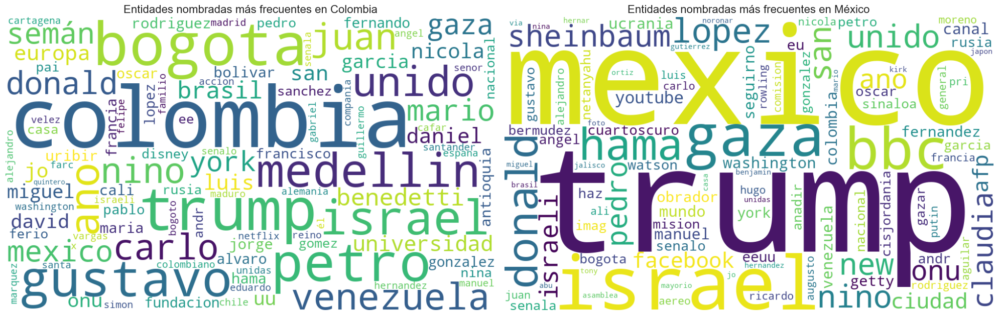

In [44]:
# Define the two countries to compare
countries = ["Colombia", "México"]

# Prepare a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

for ax, country in zip(axes, countries):
    # Extract entity texts
    entities_texts = df[df["country"] == country]["entities"].explode().dropna()
    entities_texts = [ent[0] for ent in entities_texts if isinstance(ent, tuple)]

    # Skip if no entities found
    if len(entities_texts) == 0:
        ax.set_title(f"{country} – sin datos")
        ax.axis("off")
        continue

    # Generate word cloud
    text = " ".join(entities_texts)
    wc = WordCloud(
        width=1000,
        height=600,
        background_color="white",
        max_words=100,
        collocations=False
    ).generate(text)

    # Display side-by-side
    ax.imshow(wc, interpolation="bilinear")
    ax.axis("off")
    ax.set_title(f"Entidades nombradas más frecuentes en {country}", fontsize=16)

plt.tight_layout()
plt.show()

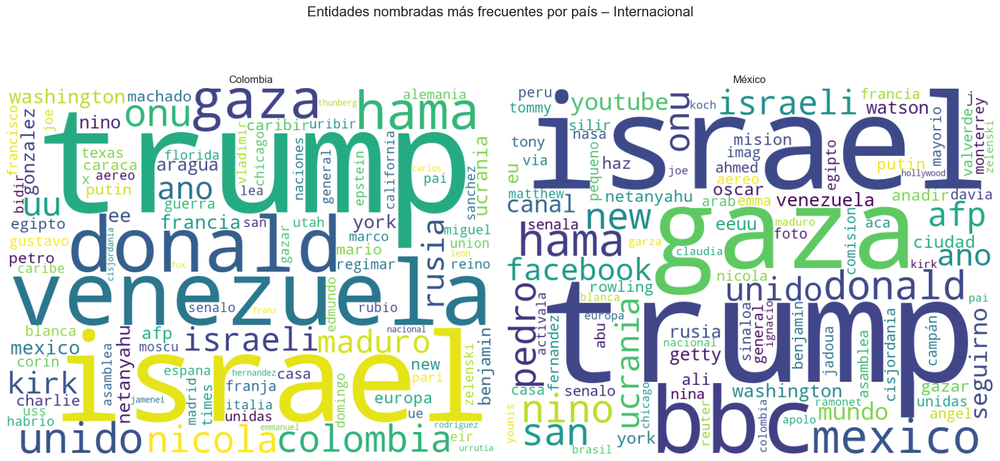

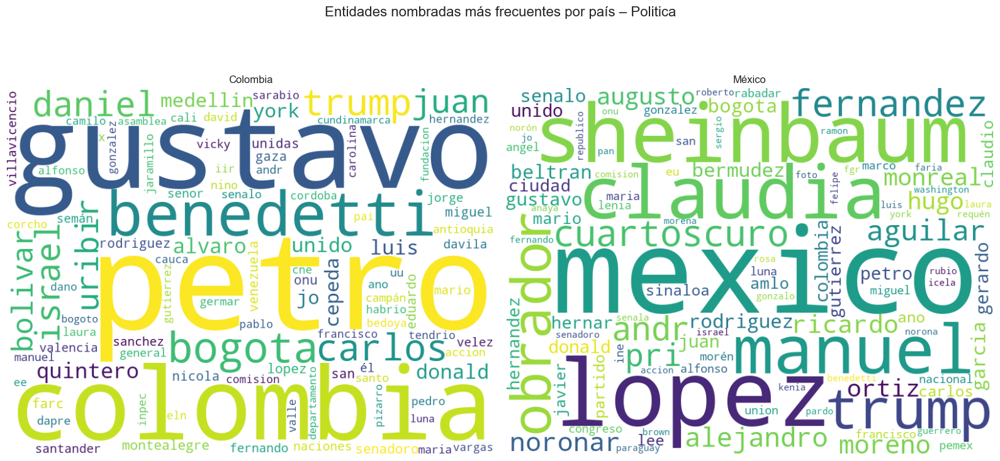

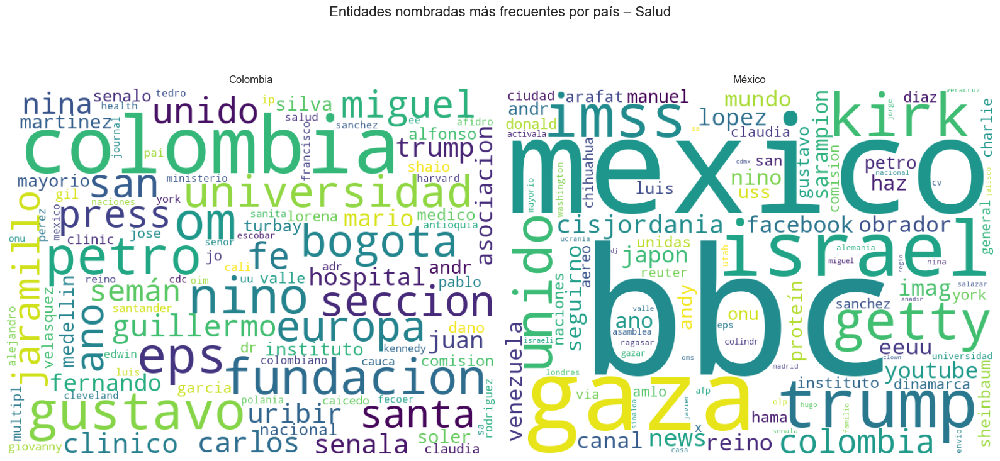

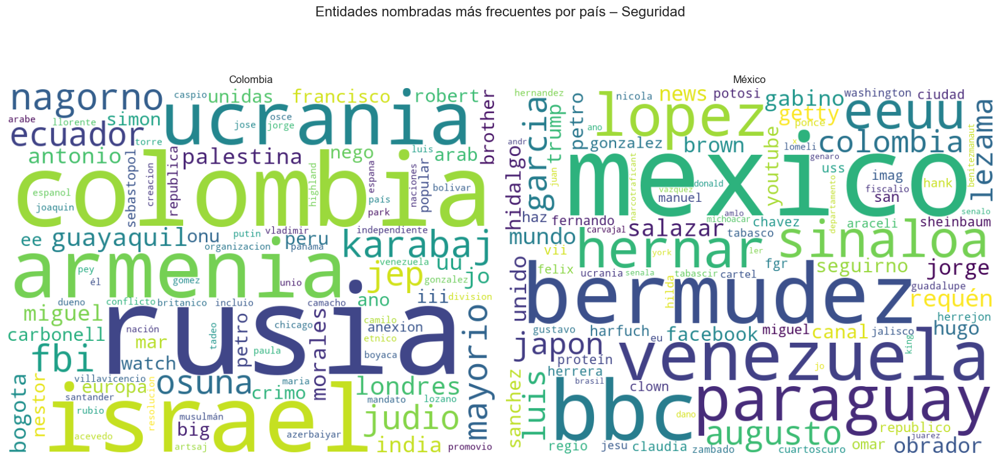

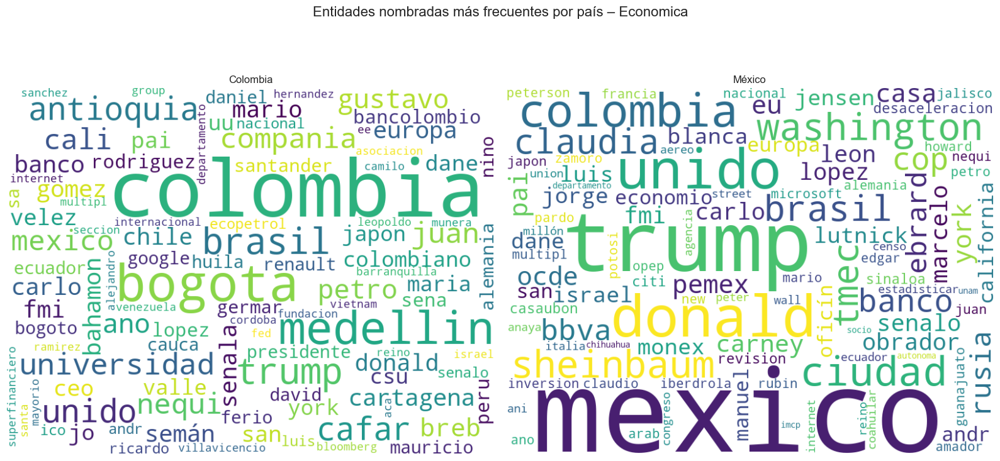

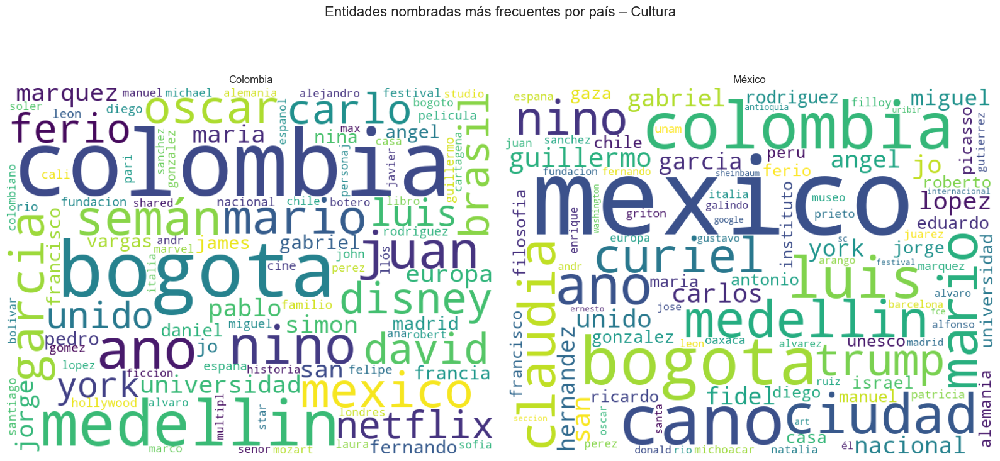

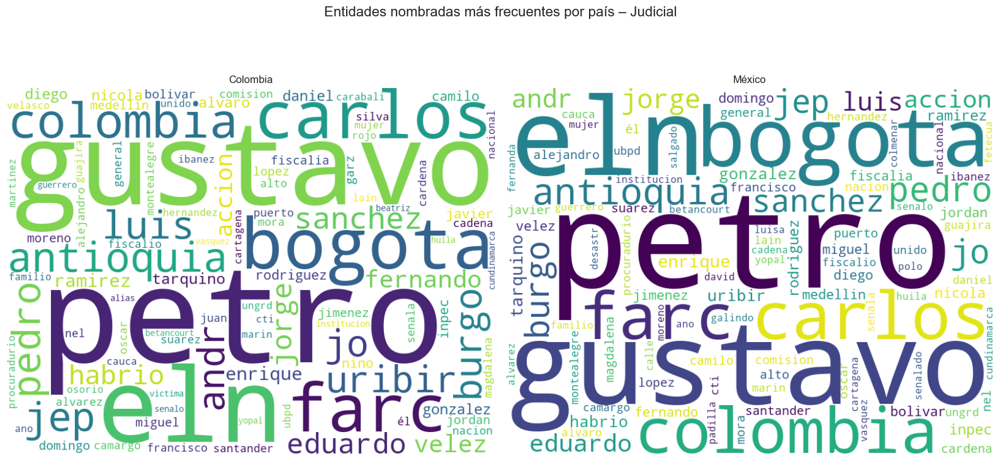

In [45]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

countries = ["Colombia", "México"]  # adjust if spelling differs

for category in df["category"].unique():
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    fig.suptitle(f"Entidades nombradas más frecuentes por país – {category}", fontsize=16)

    for i, country in enumerate(countries):
        subset = df[(df["country"] == country) & (df["category"] == category)]
        entities_texts = subset["entities"].explode().dropna()
        entities_texts = [ent[0] for ent in entities_texts if isinstance(ent, tuple)]

        if len(entities_texts) == 0:
            axes[i].axis("off")
            axes[i].set_title(f"{country} – sin datos")
            continue

        text = " ".join(entities_texts)
        wc = WordCloud(
            width=800, height=600,
            background_color="white",
            max_words=100,
            collocations=False
        ).generate(text)

        axes[i].imshow(wc, interpolation="bilinear")
        axes[i].axis("off")
        axes[i].set_title(f"{country}")

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()



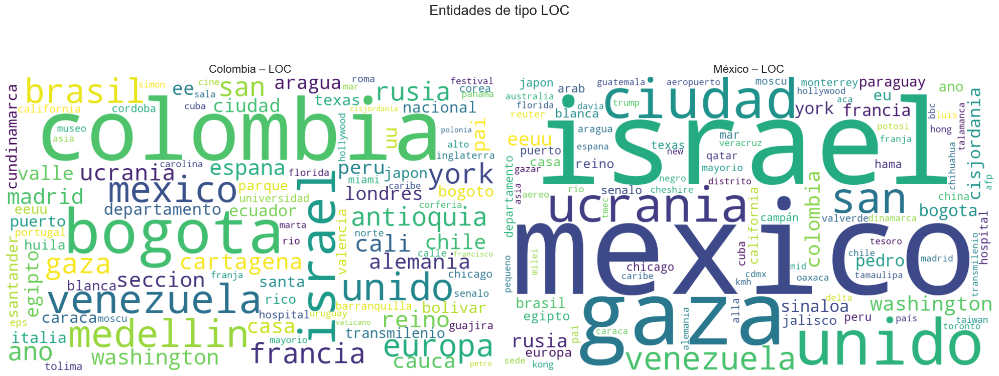

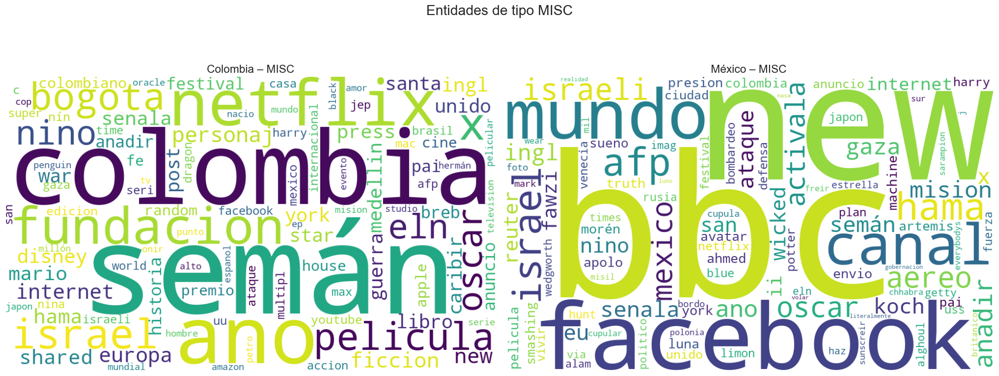

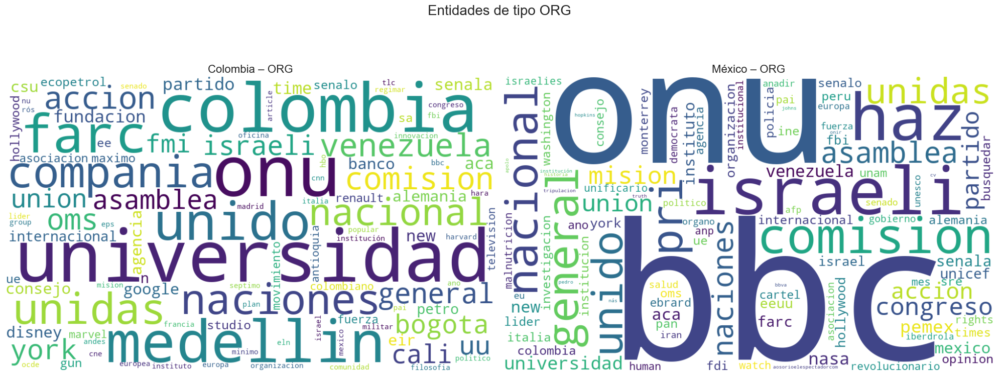

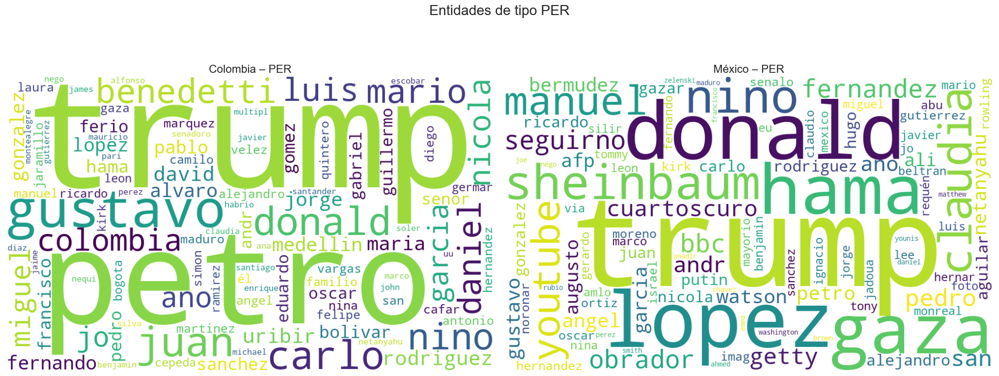

In [46]:
# Get all unique entity types across both countries
entity_types = sorted(
    set(
        ent[1]
        for ents in df["entities"].dropna().explode()
        if isinstance(ents, tuple)
        for ent in [ents]
    )
)

countries = ["Colombia", "México"]

# Loop over entity types
for entity_type in entity_types:
    fig, axes = plt.subplots(1, 2, figsize=(20, 8))

    for ax, country in zip(axes, countries):
        # Extract entities of this type for each country
        entities_texts = df[df["country"] == country]["entities"].explode().dropna()
        entities_texts = [ent[0] for ent in entities_texts if isinstance(ent, tuple) and ent[1] == entity_type]

        # Skip if none
        if len(entities_texts) == 0:
            ax.set_title(f"{country} – sin datos", fontsize=14)
            ax.axis("off")
            continue

        # Generate WordCloud
        text = " ".join(entities_texts)
        wc = WordCloud(
            width=1000, height=600,
            background_color="white",
            max_words=100,
            collocations=False
        ).generate(text)

        ax.imshow(wc, interpolation="bilinear")
        ax.axis("off")
        ax.set_title(f"{country} – {entity_type}", fontsize=16)

    fig.suptitle(f"Entidades de tipo {entity_type}", fontsize=20, y=1.02)
    plt.tight_layout()
    plt.show()

=== INTERNACIONAL ===


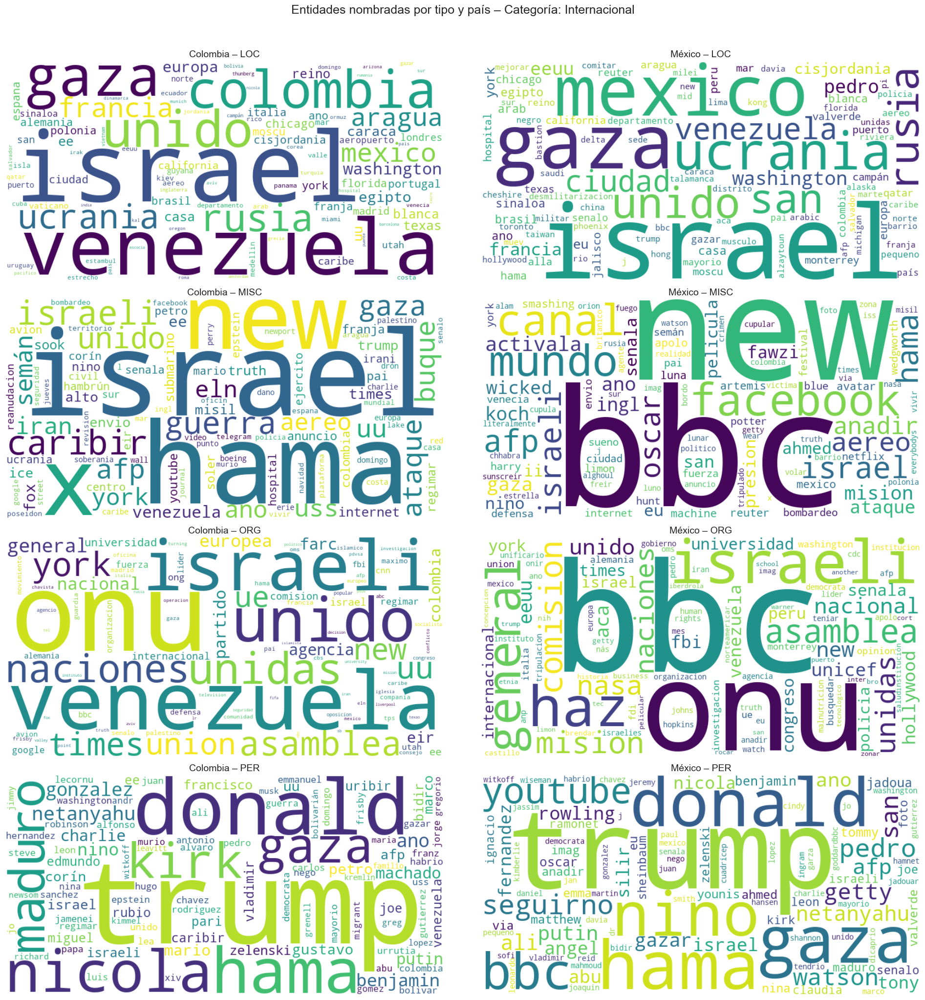

=== POLITICA ===


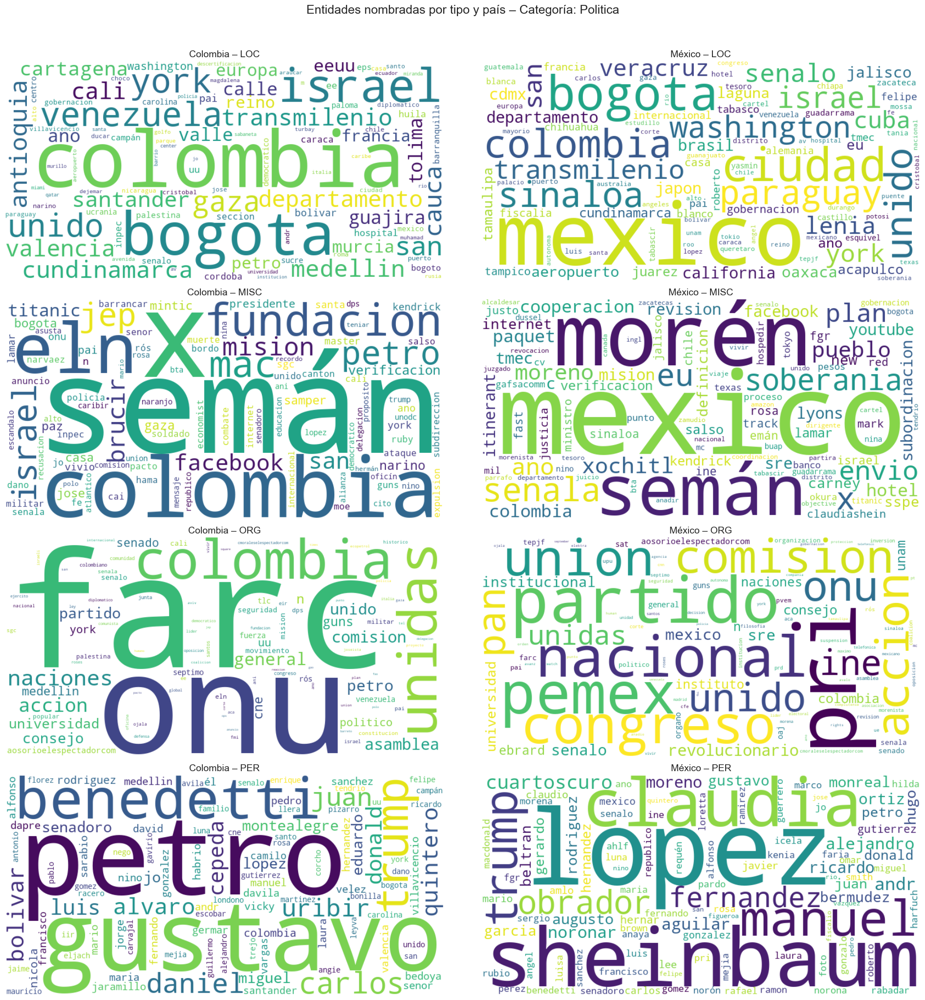

=== SALUD ===


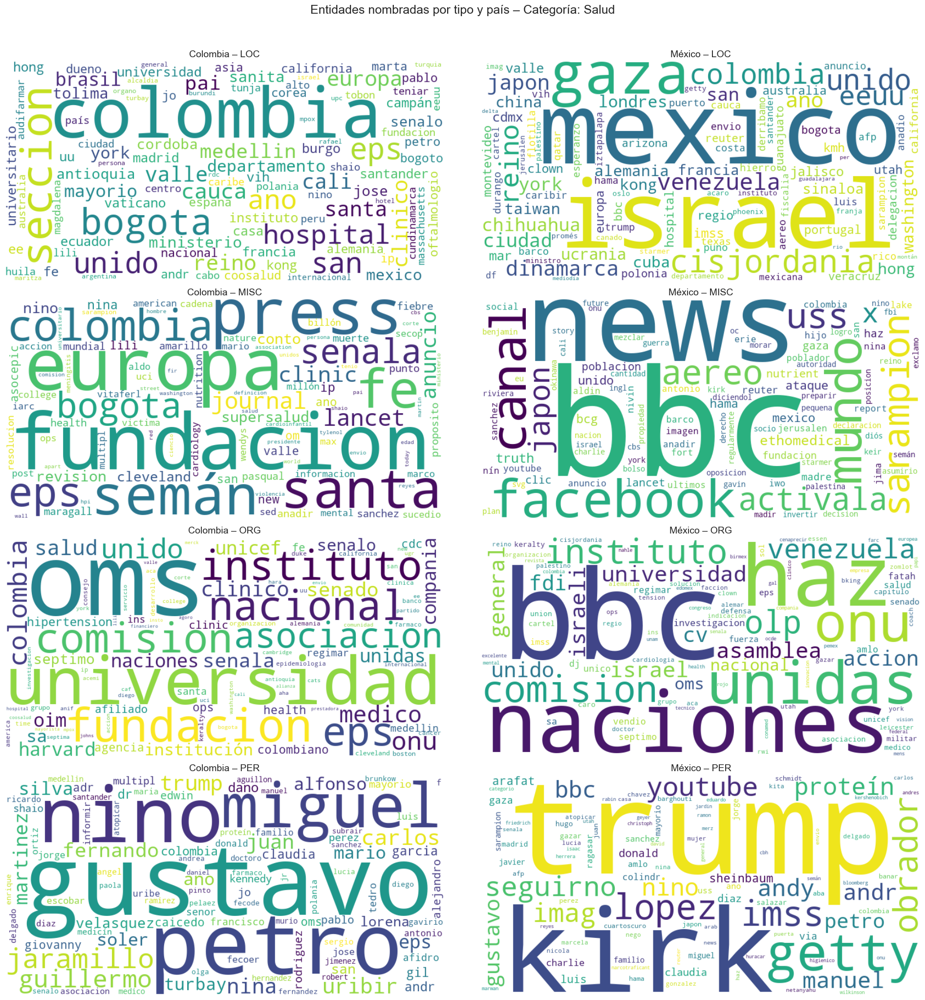

=== SEGURIDAD ===


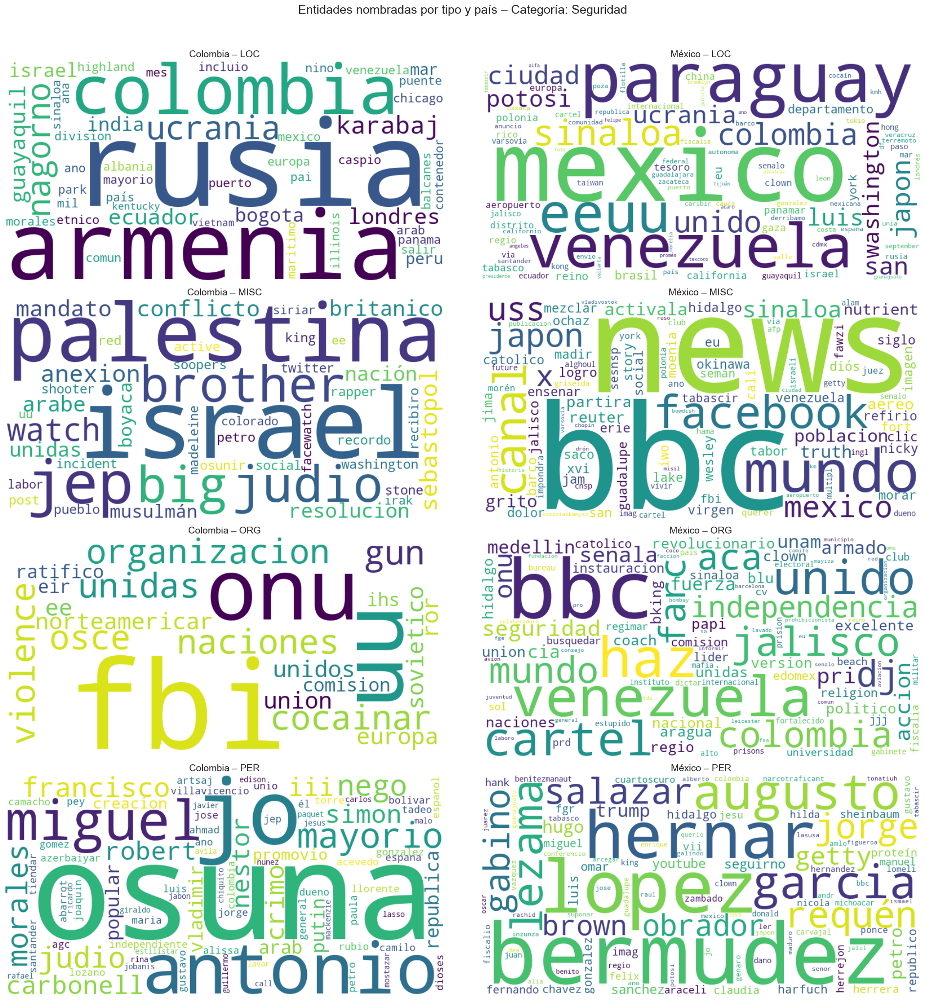

=== ECONOMICA ===


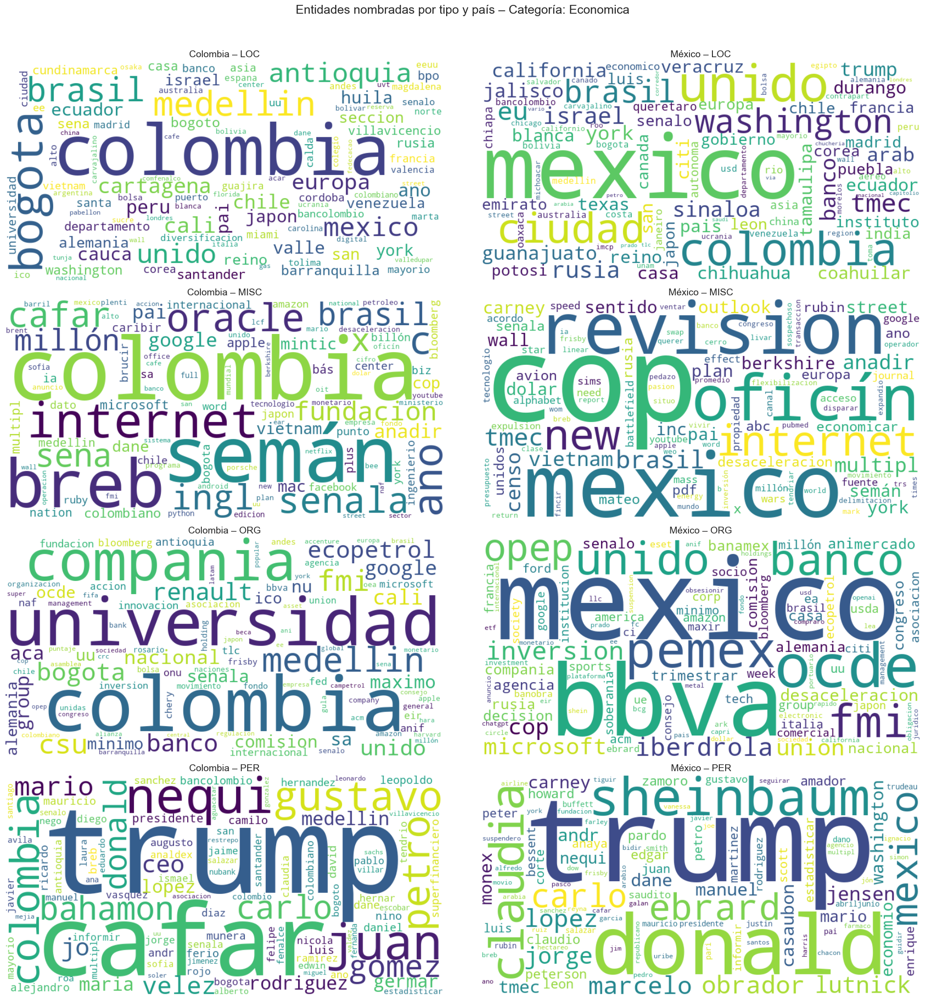

=== CULTURA ===


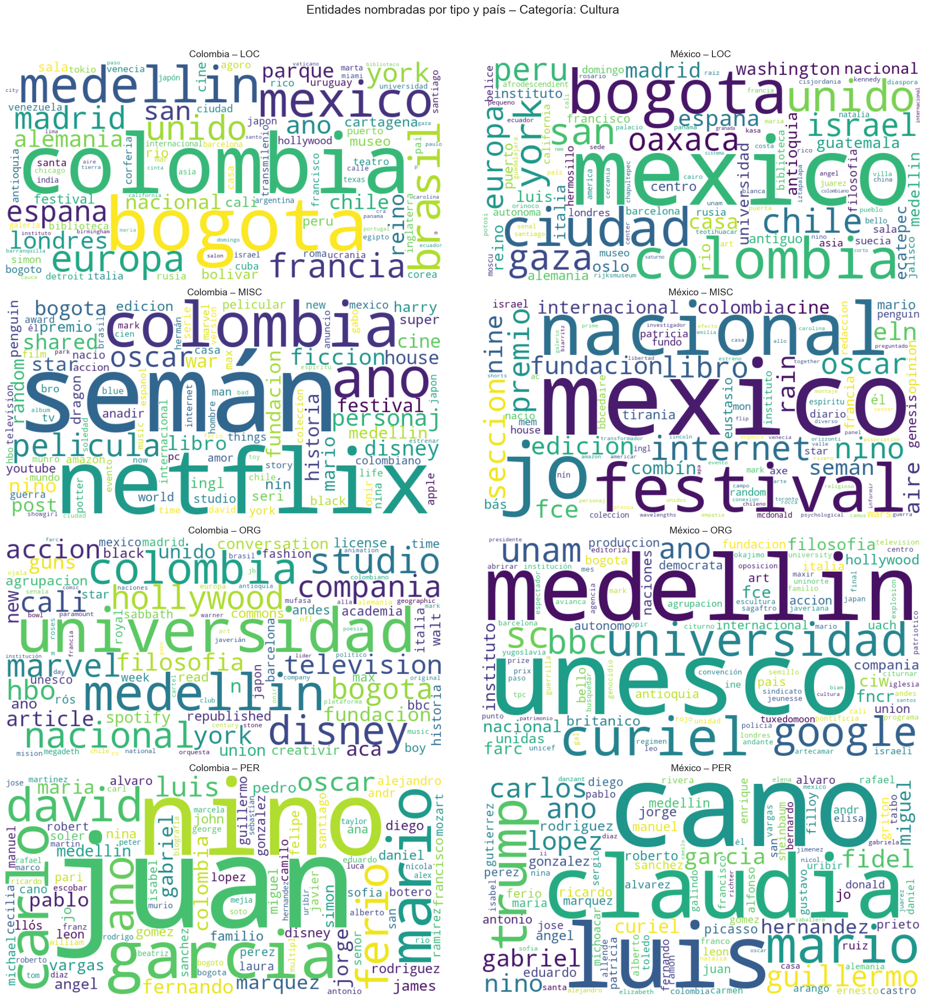

=== JUDICIAL ===


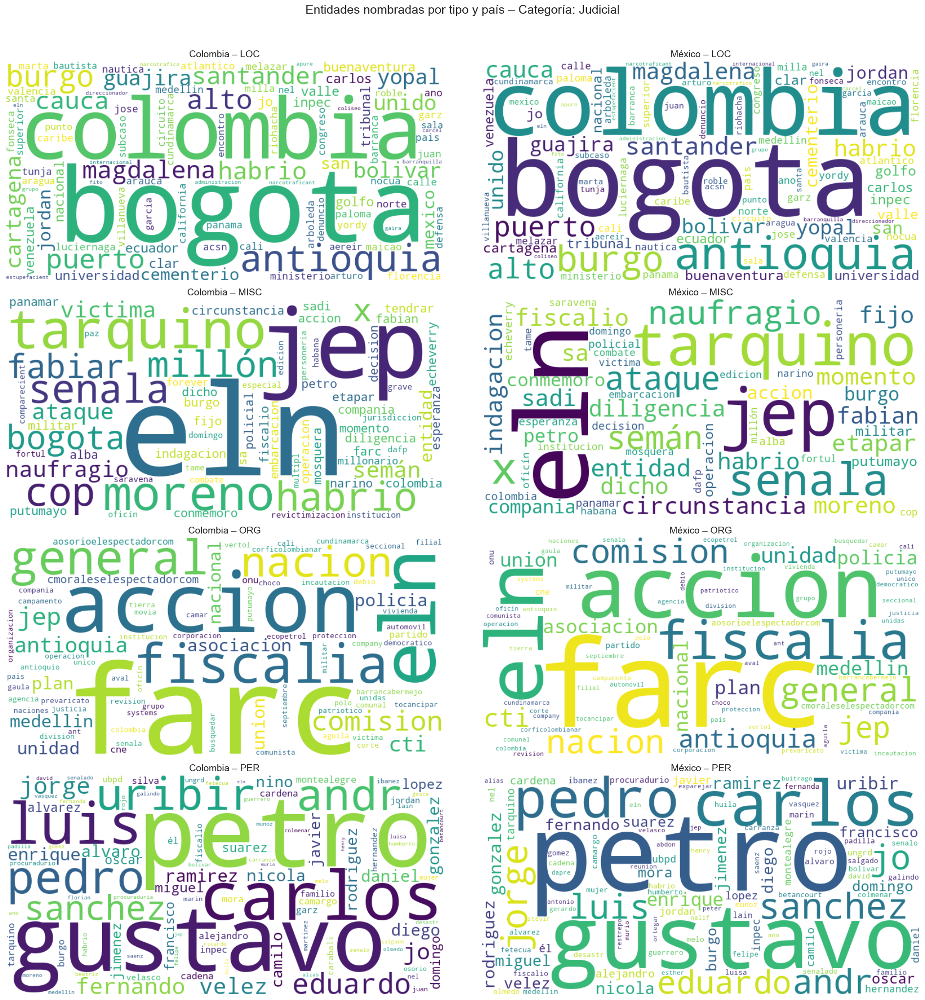

In [47]:
countries = ["Colombia", "México"]
entity_types = sorted(
    set(
        ent[1]
        for ents in df["entities"].dropna().explode()
        if isinstance(ents, tuple)
        for ent in [ents]
    )
)

# Loop over categories
for category in df["category"].unique():
    print(f"=== {category.upper()} ===")

    # One row per entity type, two columns (Colombia vs Mexico)
    fig, axes = plt.subplots(len(entity_types), 2, figsize=(20, 5 * len(entity_types)))

    if len(entity_types) == 1:
        axes = [axes]  # handle case of single entity type

    for i, entity_type in enumerate(entity_types):
        for j, country in enumerate(countries):
            ax = axes[i][j]

            subset = df[(df["country"] == country) & (df["category"] == category)]
            entities_texts = subset["entities"].explode().dropna()
            entities_texts = [ent[0] for ent in entities_texts if isinstance(ent, tuple) and ent[1] == entity_type]

            if len(entities_texts) == 0:
                ax.set_title(f"{country} – {entity_type}: sin datos", fontsize=12)
                ax.axis("off")
                continue

            # Generate WordCloud
            text = " ".join(entities_texts)
            wc = WordCloud(
                width=800, height=400,
                background_color="white",
                max_words=100,
                collocations=False
            ).generate(text)

            ax.imshow(wc, interpolation="bilinear")
            ax.axis("off")
            ax.set_title(f"{country} – {entity_type}", fontsize=14)

    fig.suptitle(f"Entidades nombradas por tipo y país – Categoría: {category}", fontsize=18, y=1.02)
    plt.tight_layout()
    plt.show()

#### Paso 3.3.2: ¿Qué entidades son exclusivas de cada país o comparten ambos?

In [48]:
# Aseguramos que 'entities' tenga formato [(texto, tipo), ...]
df_entities = df.explode("entities").dropna(subset=["entities"])
df_entities["entity_text"] = df_entities["entities"].apply(lambda x: x[0] if isinstance(x, tuple) else None)
df_entities["entity_type"] = df_entities["entities"].apply(lambda x: x[1] if isinstance(x, tuple) else None)

# Agrupamos entidades por país y tipo
entities_by_country = (
    df_entities.groupby(["country", "entity_type"])["entity_text"]
    .apply(lambda x: set(map(str.lower, x.dropna())))
    .reset_index()
)

# Unimos Colombia y México por tipo de entidad
merged = entities_by_country.pivot(index="entity_type", columns="country", values="entity_text")

# Reemplazamos NaN con conjuntos vacíos
merged = merged.applymap(lambda x: x if isinstance(x, set) else set())

# Calculamos exclusivas y compartidas
results = []
for entity_type, row in merged.iterrows():
    colombia_ents = row.get("Colombia", set())
    mexico_ents = row.get("México", set())

    exclusivas_col = colombia_ents - mexico_ents
    exclusivas_mex = mexico_ents - colombia_ents
    compartidas = colombia_ents & mexico_ents

    results.append({
        "entity_type": entity_type,
        "exclusivas_colombia": list(exclusivas_col)[:15],  # top 15
        "exclusivas_mexico": list(exclusivas_mex)[:15],
        "compartidas": list(compartidas)[:15]
    })

exclusive_df = pd.DataFrame(results)
exclusive_df

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\3689353077.py:17: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  merged = merged.applymap(lambda x: x if isinstance(x, set) else set())


,entity_type,exclusivas_colombia,exclusivas_mexico,compartidas
0,LOC,"[fenomeno nino, santa barbara, novgorod, ibaga...","[mexico mexico responderar, bebes, san diego c...","[mediacion egipto, urgio, brasilén, teatro sca..."
1,MISC,"[boeing poseidon, blue ivy carter, registrir, ...","[iran b hama c, embajadoro mexico chile alicia...","[uss lake erie, fiscalio momento, cop millón, ..."
2,ORG,"[bogota fashion week internacionalizacion, uni...","[movimiento politico unido, partido verde jose...","[dfs, unia solidaridad internacional defensa d..."
3,PER,"[gabriel enrique castilla castillo, camilo orb...","[gilberto batiz claudia valle aguilasocho, qui...","[dea, lena, francoargelín helenir, polvoro bar..."


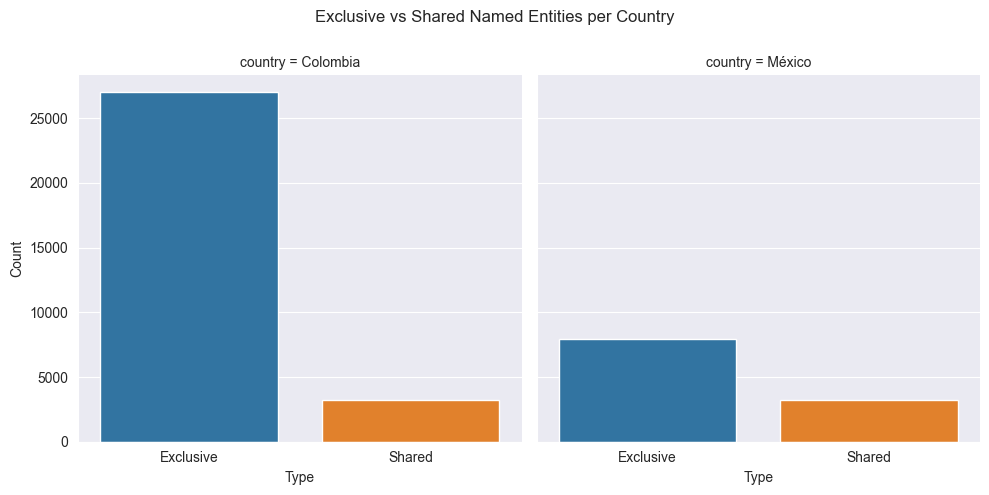

In [49]:
# Compute exclusive/shared entities per country
col_entities = set(
    ent[0].lower() for ent in df[df["country"]=="Colombia"]["entities"].explode()
    if isinstance(ent, tuple)
)
mex_entities = set(
    ent[0].lower() for ent in df[df["country"]=="México"]["entities"].explode()
    if isinstance(ent, tuple)
)

# Prepare DataFrame
plot_df = pd.DataFrame([
    {"country": "Colombia", "Type": "Exclusive", "Count": len(col_entities - mex_entities)},
    {"country": "Colombia", "Type": "Shared", "Count": len(col_entities & mex_entities)},
    {"country": "México", "Type": "Exclusive", "Count": len(mex_entities - col_entities)},
    {"country": "México", "Type": "Shared", "Count": len(col_entities & mex_entities)}
])

# Plot
sns.catplot(
    data=plot_df,
    x="Type", y="Count",
    hue="Type", col="country",
    kind="bar", dodge=False,
    height=5, sharey=True
)
plt.subplots_adjust(top=0.85)
plt.suptitle("Exclusive vs Shared Named Entities per Country")
plt.show()


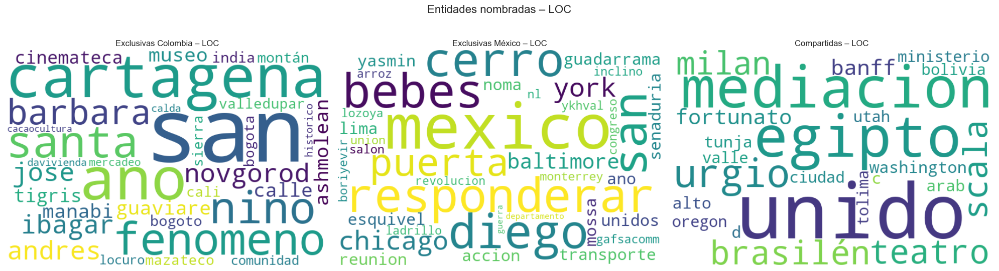

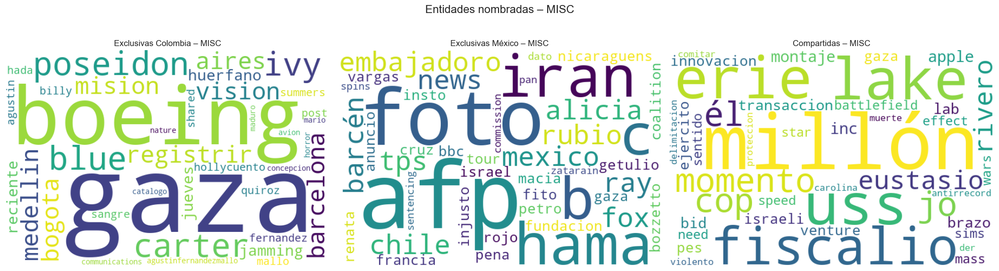

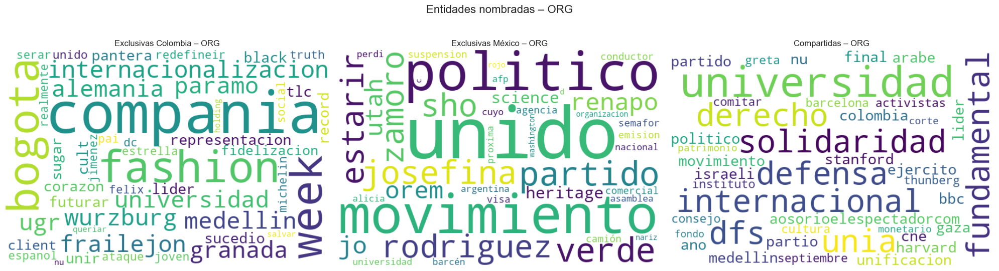

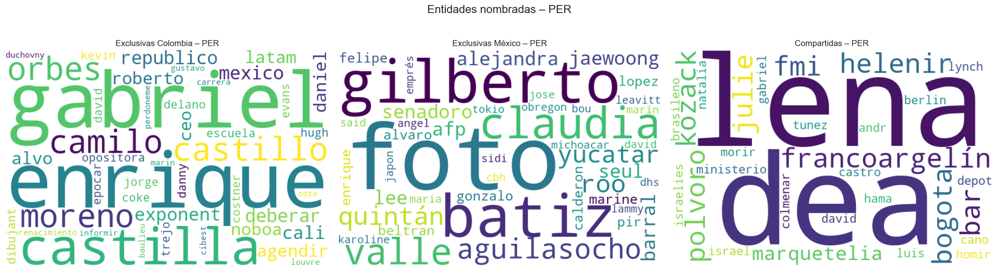

In [50]:
# Loop over each entity type
for idx, row in exclusive_df.iterrows():
    entity_type = row["entity_type"]
    colombia_text = " ".join(row["exclusivas_colombia"])
    mexico_text = " ".join(row["exclusivas_mexico"])
    shared_text = " ".join(row["compartidas"])

    # Create a figure with 3 subplots
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    # Colombia exclusive
    wc_col = WordCloud(width=600, height=400, background_color="white").generate(colombia_text)
    axes[0].imshow(wc_col, interpolation="bilinear")
    axes[0].axis("off")
    axes[0].set_title(f"Exclusivas Colombia – {entity_type}")

    # Mexico exclusive
    wc_mex = WordCloud(width=600, height=400, background_color="white").generate(mexico_text)
    axes[1].imshow(wc_mex, interpolation="bilinear")
    axes[1].axis("off")
    axes[1].set_title(f"Exclusivas México – {entity_type}")

    # Shared
    wc_shared = WordCloud(width=600, height=400, background_color="white").generate(shared_text)
    axes[2].imshow(wc_shared, interpolation="bilinear")
    axes[2].axis("off")
    axes[2].set_title(f"Compartidas – {entity_type}")

    plt.suptitle(f"Entidades nombradas – {entity_type}", fontsize=16)
    plt.tight_layout()
    plt.show()

In [51]:
# Extract sets of entities per country
entities_col = set([ent[0] for ents in df[df["country"]=="Colombia"]["entities"] if isinstance(ents, list) for ent in ents])
entities_mex = set([ent[0] for ents in df[df["country"]=="México"]["entities"] if isinstance(ents, list) for ent in ents])

# Entities exclusive to each country
exclusive_col = entities_col - entities_mex
exclusive_mex = entities_mex - entities_col

# Entities shared by both
shared_entities = entities_col & entities_mex

print(f"Exclusive to Colombia: {len(exclusive_col)} entities")
print(f"Exclusive to México: {len(exclusive_mex)} entities")
print(f"Shared: {len(shared_entities)} entities")



Exclusive to Colombia: 26984 entities
Exclusive to México: 7936 entities
Shared: 3250 entities


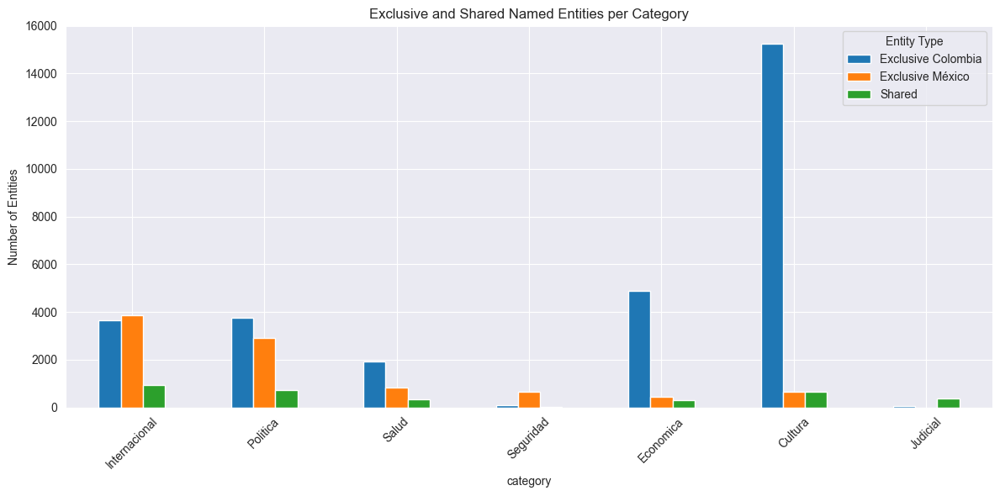

In [52]:
# Prepare a DataFrame to store counts
rows = []

for category in df["category"].unique():
    col_entities = set(
        [ent[0] for ent in df[(df["country"]=="Colombia") & (df["category"]==category)]["entities"].explode()
         if isinstance(ent, tuple)]
    )
    mex_entities = set(
        [ent[0] for ent in df[(df["country"]=="México") & (df["category"]==category)]["entities"].explode()
         if isinstance(ent, tuple)]
    )
    exclusive_col = col_entities - mex_entities
    exclusive_mex = mex_entities - col_entities
    shared = col_entities & mex_entities

    rows.append({
        "category": category,
        "Exclusive Colombia": len(exclusive_col),
        "Exclusive México": len(exclusive_mex),
        "Shared": len(shared)
    })

plot_df = pd.DataFrame(rows)

# Plot
plot_df.set_index("category").plot(kind="bar", figsize=(12,6))
plt.ylabel("Number of Entities")
plt.title("Exclusive and Shared Named Entities per Category")
plt.xticks(rotation=45)
plt.legend(title="Entity Type")
plt.tight_layout()
plt.show()

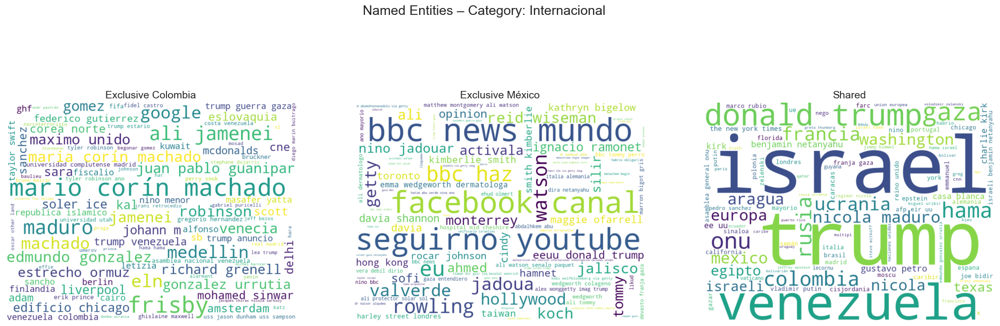

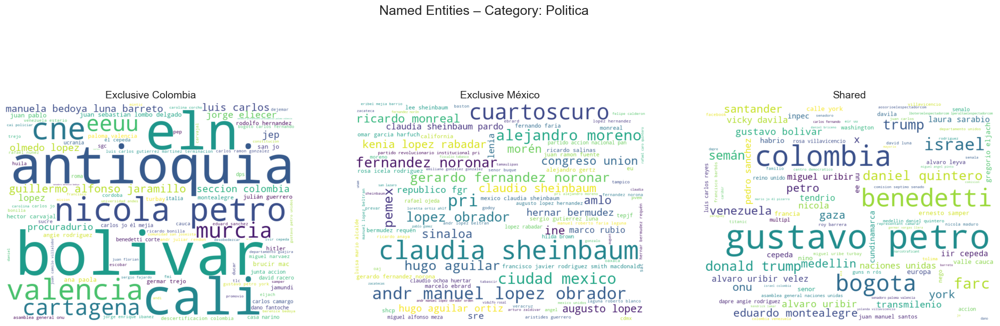

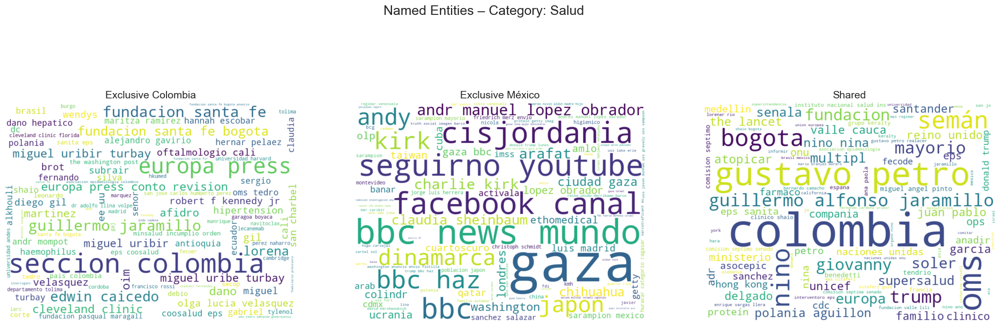

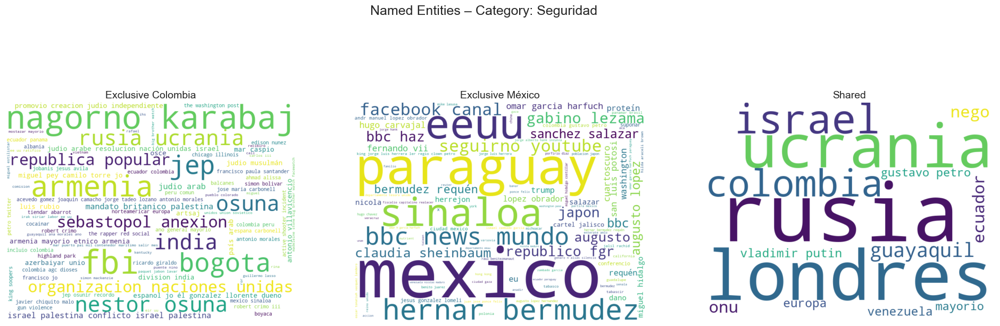

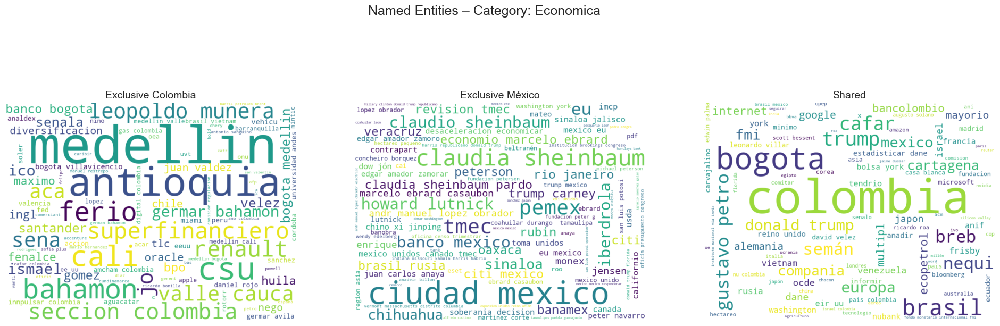

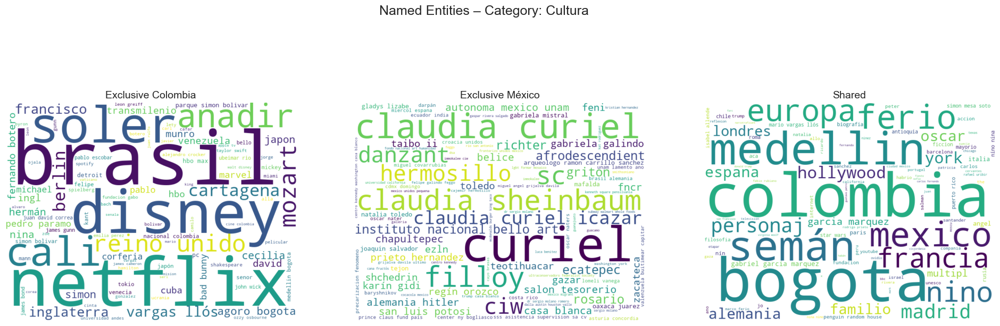

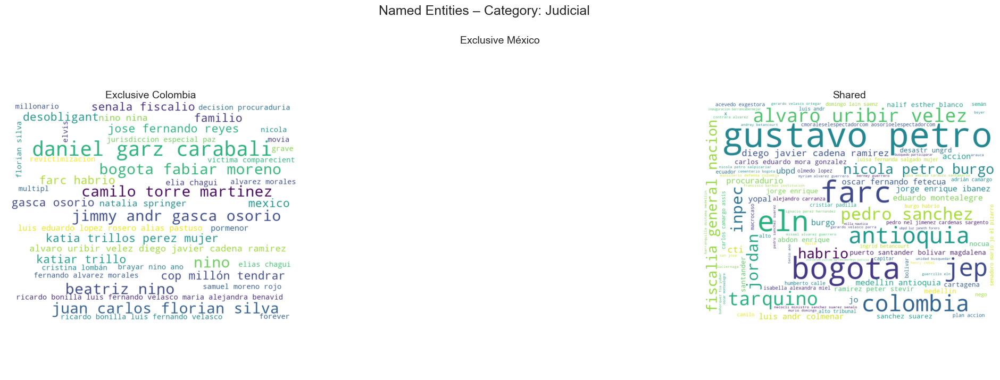

In [53]:
for category in df["category"].unique():
    # Get all entities per country
    col_entities = [ent[0] for ent in df[(df["country"]=="Colombia") & (df["category"]==category)]["entities"].explode()
                    if isinstance(ent, tuple)]
    mex_entities = [ent[0] for ent in df[(df["country"]=="México") & (df["category"]==category)]["entities"].explode()
                    if isinstance(ent, tuple)]

    # Count frequencies
    col_counter = Counter(col_entities)
    mex_counter = Counter(mex_entities)

    # Exclusive and shared entities with frequencies
    exclusive_col = {k:v for k,v in col_counter.items() if k not in mex_counter}
    exclusive_mex = {k:v for k,v in mex_counter.items() if k not in col_counter}
    shared = {k:v for k,v in col_counter.items() if k in mex_counter}

    # Create figure
    fig, axes = plt.subplots(1, 3, figsize=(24,8))
    fig.suptitle(f"Named Entities – Category: {category}", fontsize=18)

    # Word clouds
    for ax, data, title in zip(axes, [exclusive_col, exclusive_mex, shared],
                               ["Exclusive Colombia", "Exclusive México", "Shared"]):
        if data:  # Only generate if there is data
            wc = WordCloud(width=800, height=600, background_color="white", max_words=100, collocations=False)
            wc.generate_from_frequencies(data)
            ax.imshow(wc, interpolation="bilinear")
        ax.axis("off")
        ax.set_title(title, fontsize=14)

    plt.show()

#### Paso 3.3.3: ¿Qué temas predominan?

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\719633996.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


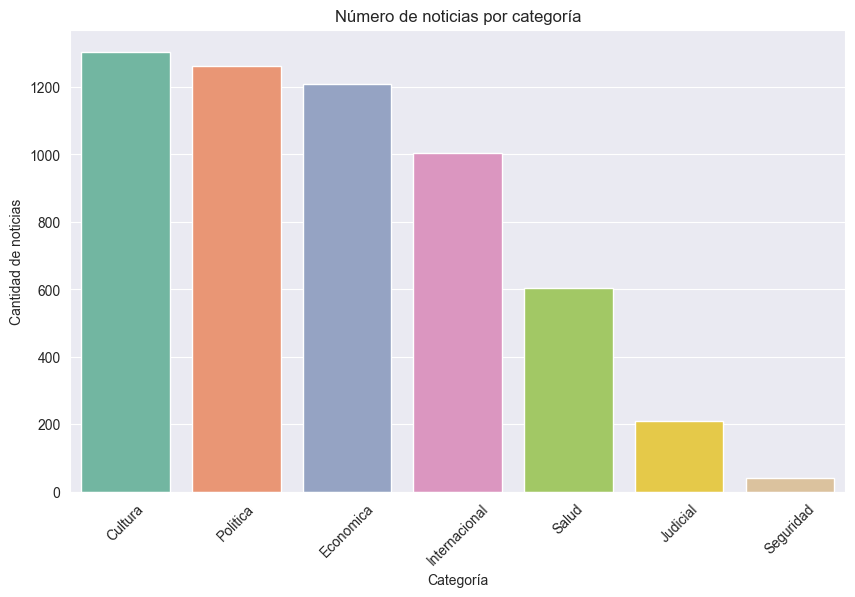

In [54]:
# Count texts per category
category_counts = df["category"].value_counts().reset_index()
category_counts.columns = ["category", "count"]

# Plot
plt.figure(figsize=(10,6))
sns.barplot(
    data=category_counts.sort_values("count", ascending=False),
    x="category",
    y="count",
    palette="Set2"
)
plt.title("Número de noticias por categoría")
plt.xlabel("Categoría")
plt.ylabel("Cantidad de noticias")
plt.xticks(rotation=45)
plt.show()

#### Paso 3.3.4: ¿Cómo varía la densidad de entidades por categoria o medio?

In [55]:
# Ensure content_tokens are lists of words
df["content_tokens"] = df["content_tokens"].apply(lambda x: x.split() if isinstance(x, str) else [])

# Ensure entities column is a list
df["entities"] = df["entities"].apply(lambda x: x if isinstance(x, list) else [])

# Compute number of entities and tokens
df["num_entities"] = df["entities"].apply(len)
df["num_tokens"] = df["content_tokens"].apply(len)

In [56]:
# Compute entity density safely
df["entity_density"] = df.apply(
    lambda row: row["num_entities"] / row["num_tokens"] if row["num_tokens"] > 0 else 0, axis=1
)

# Quick check
df[["num_entities", "num_tokens", "entity_density"]].head()

,num_entities,num_tokens,entity_density
0,78,988,0.078947
1,89,1549,0.057456
2,154,1342,0.114754
3,113,1292,0.087461
4,52,510,0.101961


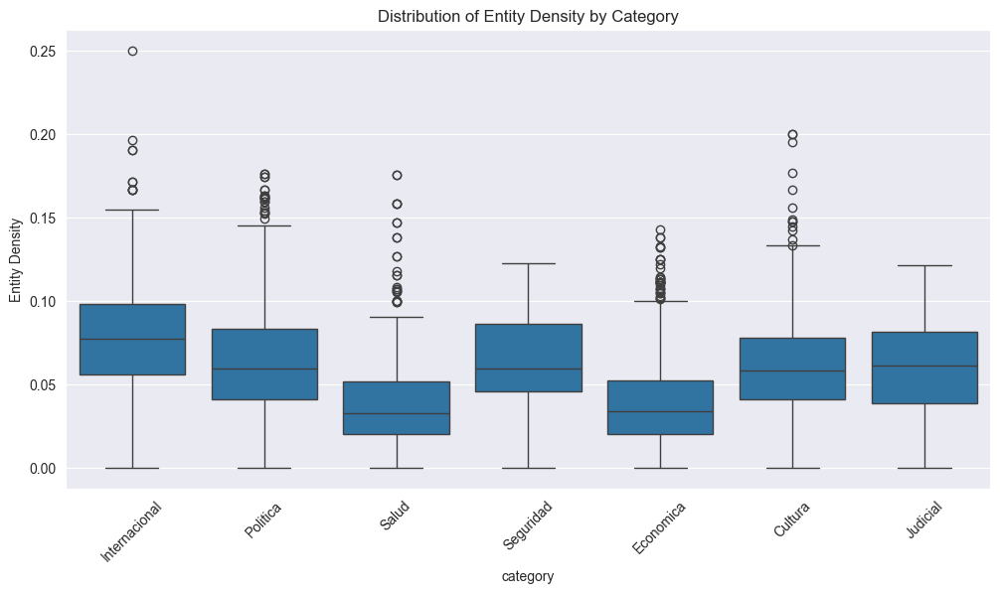

In [57]:
plt.figure(figsize=(12,6))
sns.boxplot(data=df, x="category", y="entity_density")
plt.ylabel("Entity Density")
plt.xticks(rotation=45)
plt.title("Distribution of Entity Density by Category")
plt.show()


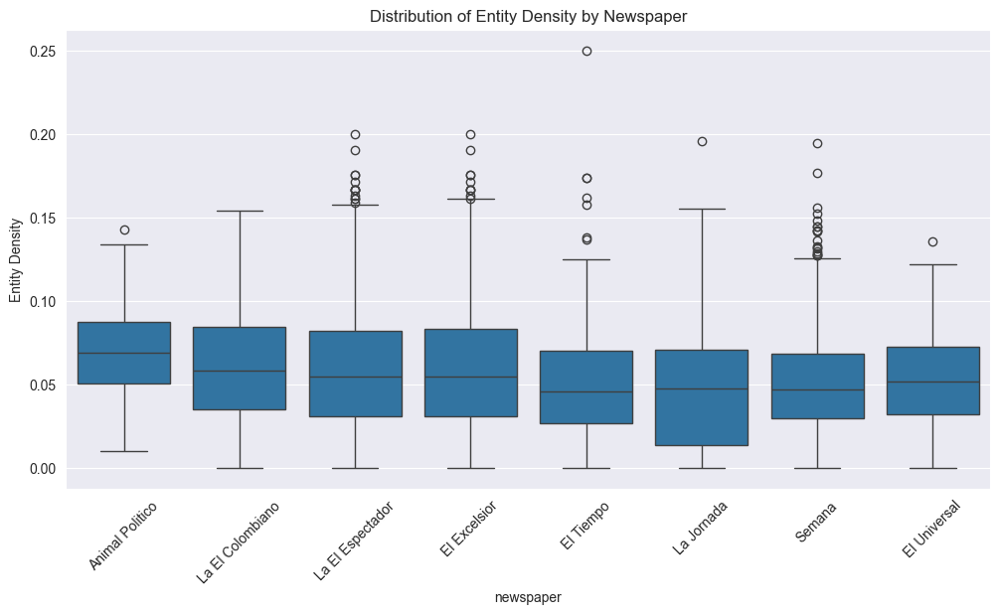

In [58]:
plt.figure(figsize=(12,6))
sns.boxplot(data=df, x="newspaper", y="entity_density")
plt.ylabel("Entity Density")
plt.xticks(rotation=45)
plt.title("Distribution of Entity Density by Newspaper")
plt.show()

#### Paso 3.3.5: ¿Qué entidades se asocian a los temas más recurrentes (por ejemplo, “ONU” con “Relaciones Internacionales”)?

In [59]:
# Make sure entities column is a list of tuples
df["entities"] = df["entities"].apply(lambda x: x if isinstance(x, list) else [])

# Extract only the entity text
df["entity_texts"] = df["entities"].apply(lambda ents: [e[0] for e in ents if isinstance(e, tuple)])

In [60]:
df_exploded = df.explode("entity_texts").dropna(subset=["entity_texts"])

In [61]:
entity_topic_freq = (
    df_exploded.groupby(["category", "entity_texts"])
    .size()
    .reset_index(name="frequency")
    .sort_values(["category", "frequency"], ascending=[True, False])
)

In [62]:
entity_topic_freq = (
    df_exploded.groupby(["category", "entity_texts"])
    .size()
    .reset_index(name="frequency")
    .sort_values(["category", "frequency"], ascending=[True, False])
)

In [63]:
top_entities_per_category = (
    entity_topic_freq.groupby("category")
    .head(10)  # top 10 entities per category
)
top_entities_per_category


,category,entity_texts,frequency
1890,Cultura,bogota,457
3271,Cultura,colombia,451
10157,Cultura,medellin,225
13940,Cultura,semán,199
10365,Cultura,mexico,192
...,...,...,...
41823,Seguridad,hernar bermudez,21
41597,Seguridad,bbc news mundo,18
41745,Seguridad,facebook canal,18
42146,Seguridad,seguirno youtube,18


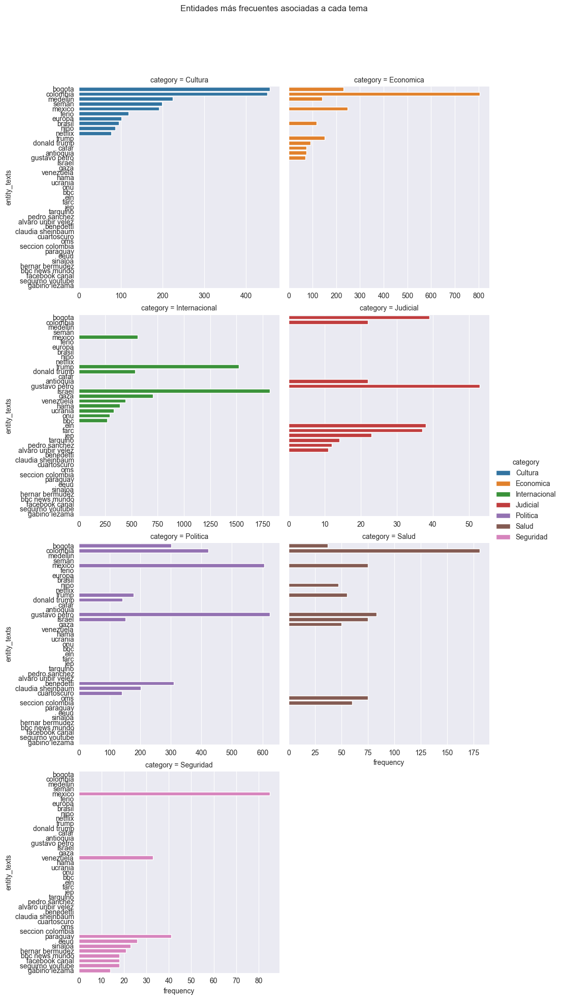

In [64]:
import seaborn as sns
import matplotlib.pyplot as plt

g = sns.catplot(
    data=top_entities_per_category,
    x="frequency",
    y="entity_texts",
    hue="category",
    kind="bar",
    col="category",
    col_wrap=2,
    dodge=False,
    sharex=False,
    height=5
)

plt.subplots_adjust(top=0.9)
plt.suptitle("Entidades más frecuentes asociadas a cada tema")
plt.show()

### Paso 3.4: Análisis morfosintáctico y de estilo

Propósito: Detectar diferencias en el estilo periodístico y la estructura gramatical que podrían influir en el tipo de preguntas o respuestas que se pueden generar.

#### Paso 3.4.1: ¿Qué categorías gramaticales (sustantivos, verbos, adjetivos, etc.) predominan en cada país o sección?

In [65]:
def get_pos_tags(text):
    """
    Input: string
    Output: list of POS tags
    """
    doc = nlp(text)
    return [token.pos_ for token in doc]


In [66]:
# Create a new column with POS tags
df["pos_tags"] = df["content"].apply(lambda x: get_pos_tags(x) if isinstance(x, str) else [])

In [67]:
df_pos = df.explode("pos_tags").dropna(subset=["pos_tags"])

In [68]:
pos_counts = (
    df_pos.groupby(["country", "category", "pos_tags"])
    .size()
    .reset_index(name="count")
    .sort_values(["country", "category", "count"], ascending=[True, True, False])
)
pos_counts.head(20)

,country,category,pos_tags,count
7,Colombia,Cultura,NOUN,190251
1,Colombia,Cultura,ADP,146372
5,Colombia,Cultura,DET,132418
12,Colombia,Cultura,PUNCT,131508
16,Colombia,Cultura,VERB,90159
11,Colombia,Cultura,PROPN,82324
0,Colombia,Cultura,ADJ,68211
10,Colombia,Cultura,PRON,57616
4,Colombia,Cultura,CCONJ,36297
2,Colombia,Cultura,ADV,34045


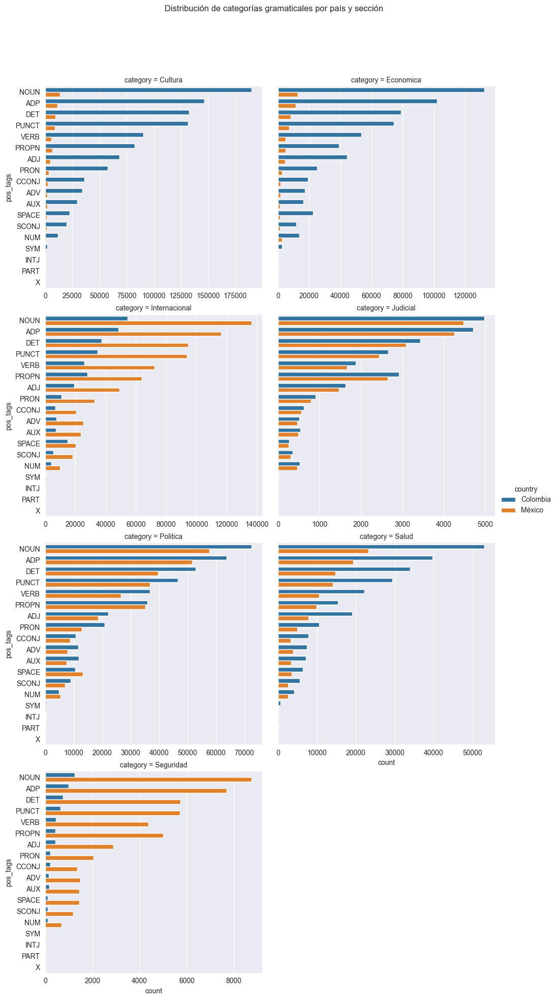

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt

# Example: POS distribution per country
g = sns.catplot(
    data=pos_counts,
    x="count",
    y="pos_tags",
    hue="country",
    col="category",  # optional, to separate by section
    kind="bar",
    col_wrap=2,
    sharex=False,
    height=5,
    dodge=True
)

plt.subplots_adjust(top=0.9)
plt.suptitle("Distribución de categorías gramaticales por país y sección")
plt.show()

#### Paso 3.4.2: ¿Qué tan diversa es la estructura léxica entre secciones (índices de diversidad léxica o entropía)?

In [70]:
# If content_tokens are already tokenized
def lexical_diversity(tokens):
    if len(tokens) == 0:
        return 0
    return len(set(tokens)) / len(tokens)

# Apply per text
df["lexical_diversity"] = df["content_tokens"].apply(lambda x: lexical_diversity(x) if isinstance(x, list) else 0)


In [71]:
lex_div_by_category = (
    df.groupby("category")["lexical_diversity"]
    .mean()
    .sort_values(ascending=False)
    .reset_index()
)
lex_div_by_category


,category,lexical_diversity
0,Judicial,0.792341
1,Salud,0.758182
2,Cultura,0.754181
3,Economica,0.743021
4,Politica,0.733451
5,Internacional,0.727534
6,Seguridad,0.697251


In [72]:
def shannon_entropy(tokens):
    if not tokens:
        return 0
    counts = np.array(list(Counter(tokens).values()))
    probs = counts / counts.sum()
    return -(probs * np.log2(probs)).sum()

# Apply per text
df["entropy"] = df["content_tokens"].apply(lambda x: shannon_entropy(x) if isinstance(x, list) else 0)

In [73]:
entropy_by_category = (
    df.groupby("category")["entropy"]
    .mean()
    .sort_values(ascending=False)
    .reset_index()
)
entropy_by_category


,category,entropy
0,Seguridad,7.742374
1,Cultura,7.273735
2,Internacional,7.209182
3,Economica,6.891542
4,Salud,6.728106
5,Politica,6.705495
6,Judicial,5.979230


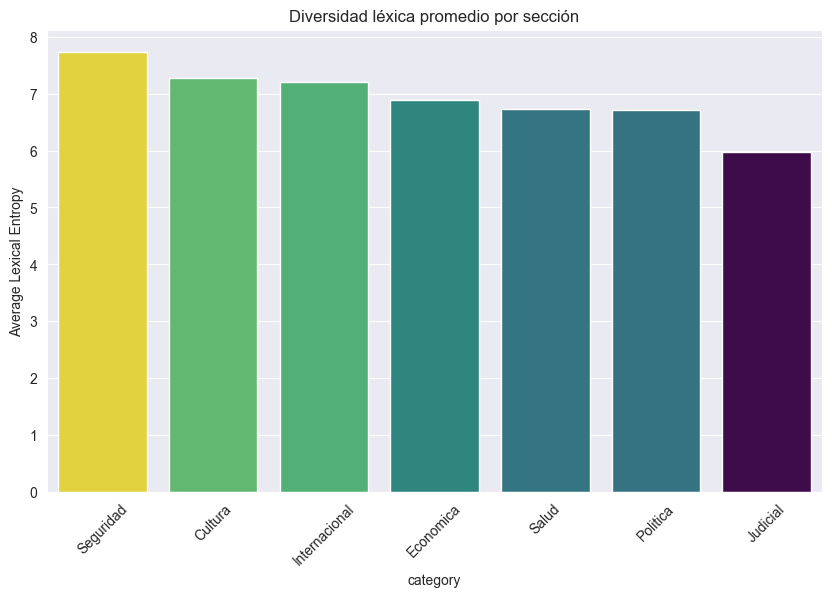

In [74]:
plt.figure(figsize=(10,6))
sns.barplot(data=entropy_by_category, x="category", y="entropy", hue="entropy", palette="viridis", legend=False)
plt.xticks(rotation=45)
plt.ylabel("Average Lexical Entropy")
plt.title("Diversidad léxica promedio por sección")
plt.show()

#### Paso 3.4.3: ¿Existen patrones de estilo o formalidad distintos por tipo de periódico o país?

In [78]:
# Longitud promedio de oraciones
df["avg_sentence_length"] = df["content_sentence_tokenization"].apply(
    lambda sents: np.mean([len(sent.split()) for sent in sents]) if isinstance(sents, list) and len(sents) > 0 else 0
)

# Longitud promedio de palabras
df["avg_word_length"] = df["content_tokens"].apply(
    lambda tokens: np.mean([len(token) for token in tokens]) if isinstance(tokens, list) and len(tokens) > 0 else 0
)


In [79]:
df["flesch_reading_ease"] = df["content_removed_unwanted_elements"].apply(lambda x: textstat.flesch_reading_ease(x) if isinstance(x, str) else 0)

In [80]:
df["lexical_diversity"] = df["content_tokens"].apply(lambda x: len(set(x))/len(x) if len(x) > 0 else 0)

In [81]:
df_grouped = df.groupby(["country", "newspaper"]).agg({
    "flesch_reading_ease": "mean",
    "avg_sentence_length": "mean",
    "lexical_diversity": "mean"
}).reset_index()

C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:5: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45)
C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45)
C:\Users\guill\AppData\Local\Temp\ipykernel_59120\2938499745.py:13: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45)


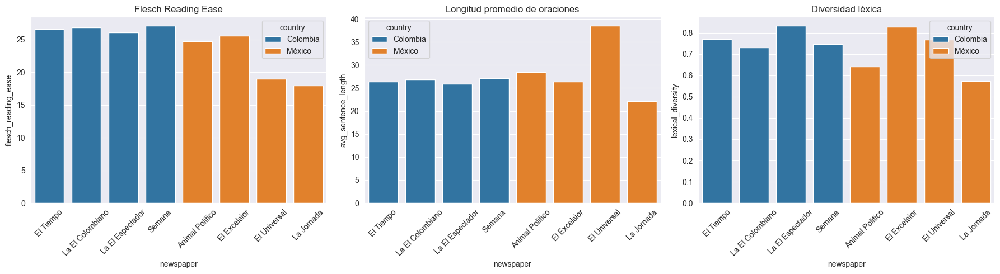

In [82]:
fig, axes = plt.subplots(1, 3, figsize=(18,5))

sns.barplot(data=df_grouped, x="newspaper", y="flesch_reading_ease", hue="country", ax=axes[0])
axes[0].set_title("Flesch Reading Ease")
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45)

sns.barplot(data=df_grouped, x="newspaper", y="avg_sentence_length", hue="country", ax=axes[1])
axes[1].set_title("Longitud promedio de oraciones")
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45)

sns.barplot(data=df_grouped, x="newspaper", y="lexical_diversity", hue="country", ax=axes[2])
axes[2].set_title("Diversidad léxica")
axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45)

plt.tight_layout()
plt.show()


## Paso 4: Desarrollar la metodología para generar preguntas y respuestas automáticas

Propósito:
Evaluar la calidad estructural y semántica de los textos para determinar su potencial en la generación automática de preguntas y respuestas.

### Paso 4.1: ¿Qué porcentaje de noticias tiene párrafos con oraciones bien formadas (sin errores o repeticiones)?

In [83]:
def is_well_formed_sentence(sent):
    sent = sent.strip()
    if len(sent) == 0:
        return False

    # Remove leading non-letter characters (quotes, parentheses, etc.)
    first_char = re.sub(r'^[^A-Za-zÁÉÍÓÚÑáéíóúñ]+', '', sent)
    if len(first_char) == 0:
        return False

    # Check if starts with uppercase
    if not first_char[0].isupper():
        return False

    # Check if ends with valid punctuation
    if sent[-1] not in ".!?":
        return False

    # Check repeated words
    words = [unidecode.unidecode(w.lower()) for w in sent.split()]
    for i in range(len(words)-1):
        if words[i] == words[i+1]:
            return False

    return True

In [84]:
def is_well_formed_paragraph(paragraph):
    sentences = re.split(r'(?<=[.!?¿¡]) +', paragraph)
    if len(sentences) == 0:
        return False

    # Paragraph is well-formed if all sentences are well-formed
    return all(is_well_formed_sentence(s) for s in sentences)

In [88]:
# Apply to dataframe
df["well_formed_paragraph"] = df["content_removed_unwanted_elements"].apply(
    lambda x: is_well_formed_paragraph(x) if isinstance(x, str) else False
)

In [89]:
# Compute percentage of well-formed paragraphs
percentage = df["well_formed_paragraph"].mean() * 100
print(f"Porcentaje de noticias con párrafos bien formados: {percentage:.2f}%")

Porcentaje de noticias con párrafos bien formados: 44.67%


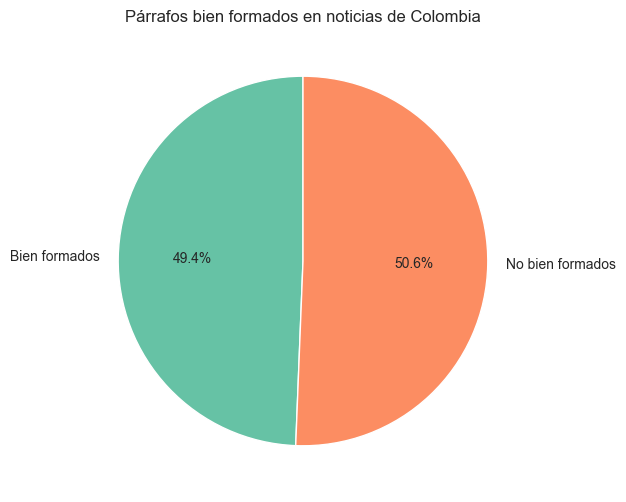

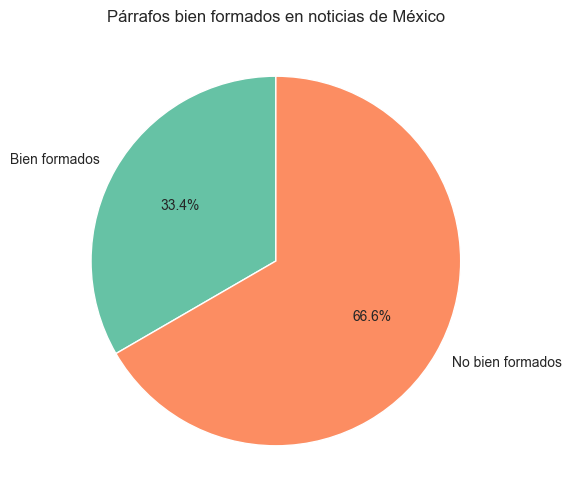

In [93]:
# Compute counts per country
df_grouped = df.groupby("country")["well_formed_paragraph"].mean().reset_index()
df_grouped["well_formed_pct"] = df_grouped["well_formed_paragraph"] * 100
df_grouped["not_well_formed_pct"] = 100 - df_grouped["well_formed_pct"]

for i, row in df_grouped.iterrows():
    labels = ["Bien formados", "No bien formados"]
    sizes = [row["well_formed_pct"], row["not_well_formed_pct"]]

    plt.figure(figsize=(6,6))
    plt.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=["#66c2a5","#fc8d62"])
    plt.title(f"Párrafos bien formados en noticias de {row['country']}")
    plt.show()


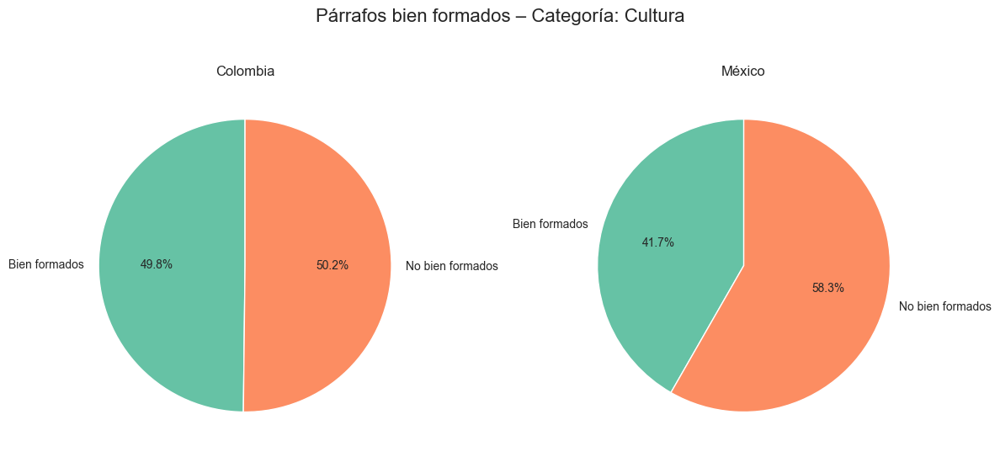

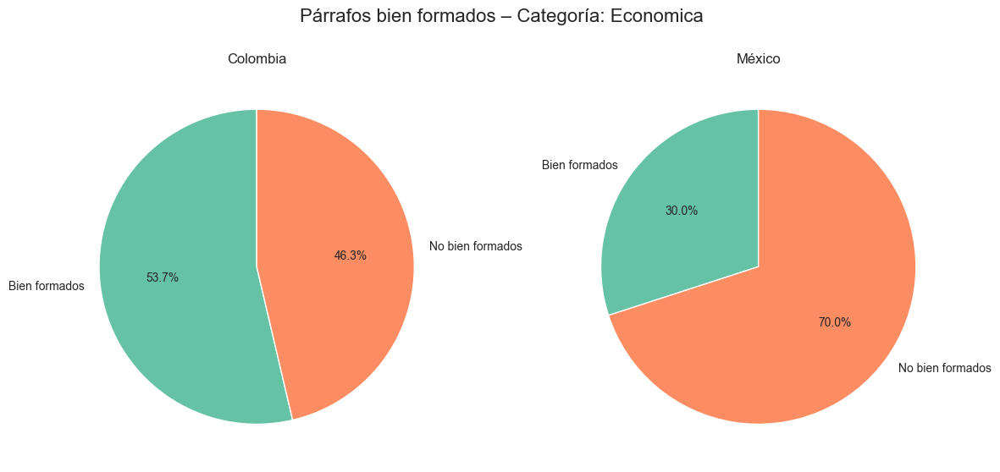

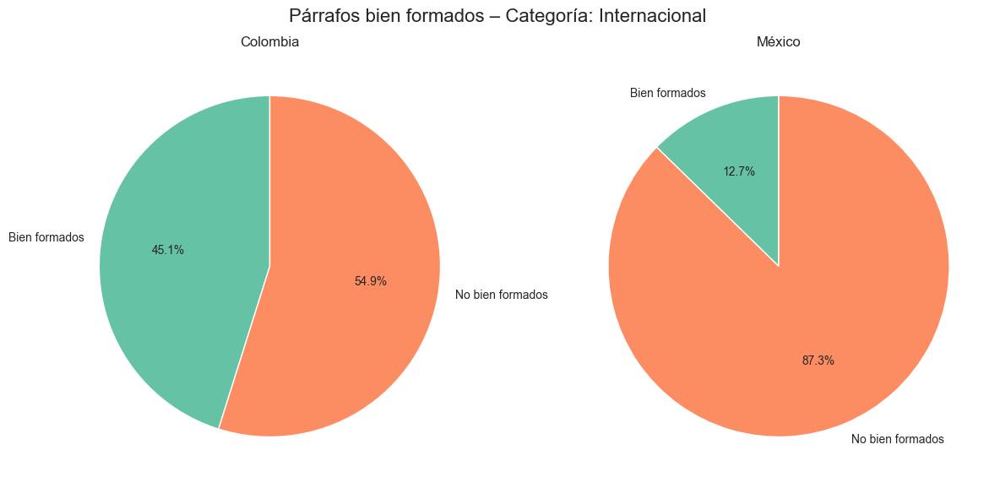

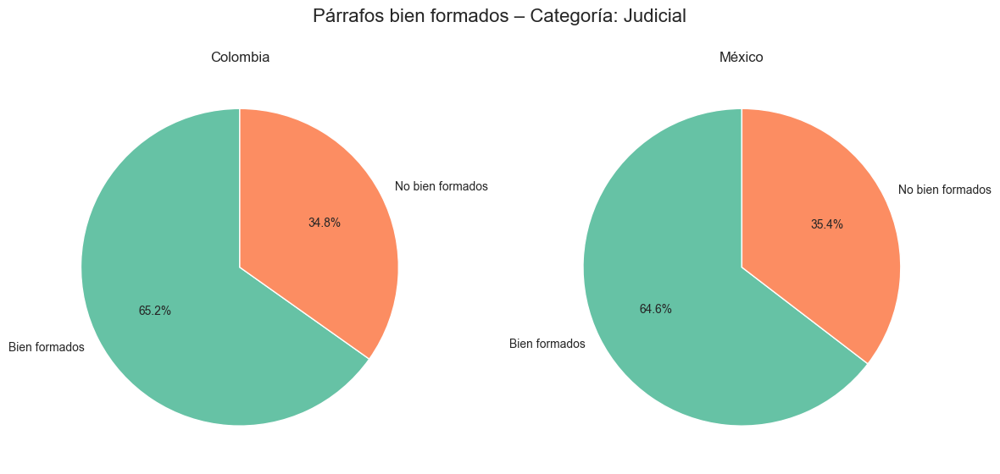

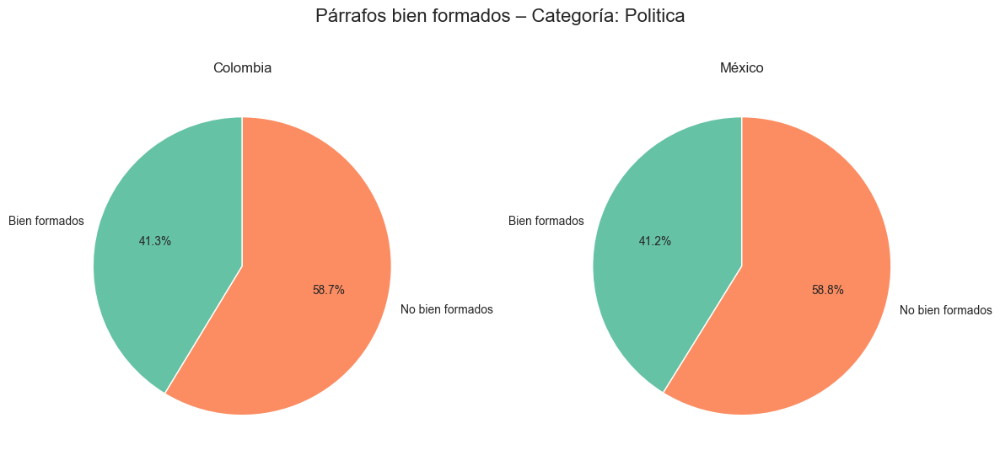

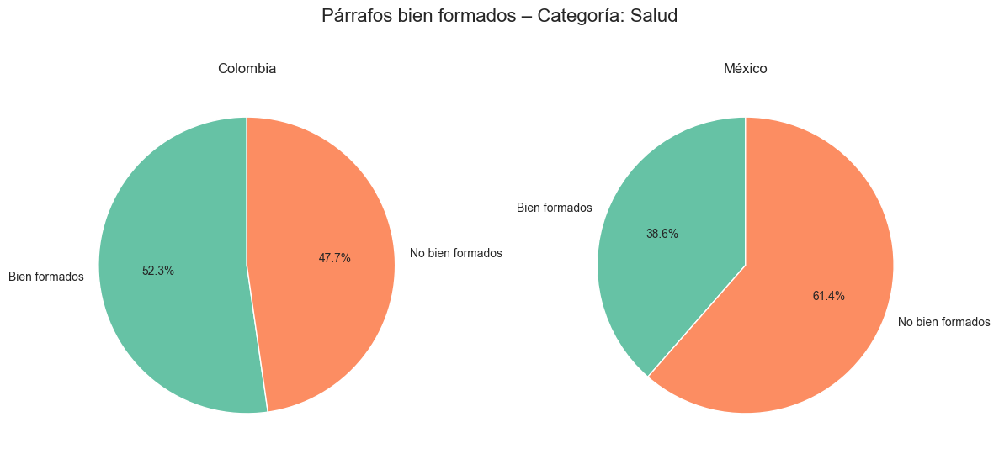

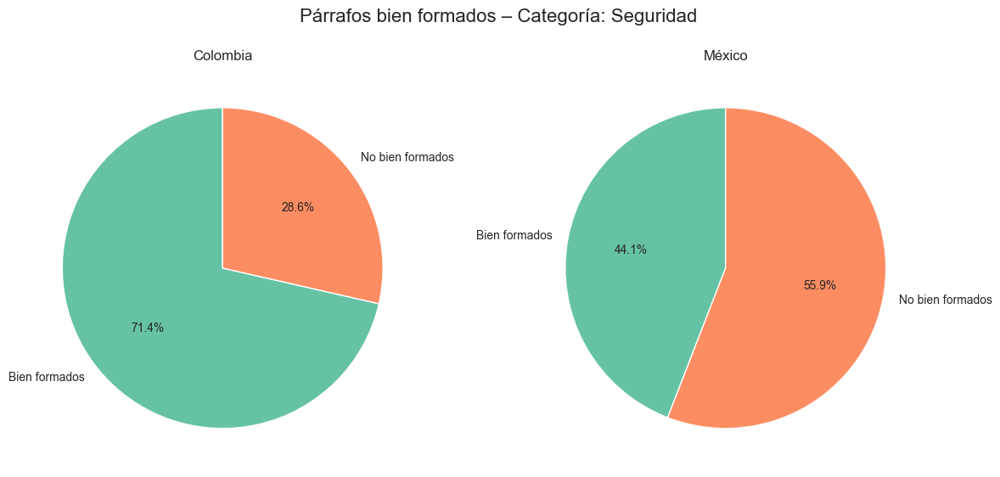

In [95]:
# Compute mean well-formed paragraphs per country and category
df_grouped = (
    df.groupby(["country", "category"])["well_formed_paragraph"]
    .mean()
    .reset_index()
)

df_grouped["well_formed_pct"] = df_grouped["well_formed_paragraph"] * 100
df_grouped["not_well_formed_pct"] = 100 - df_grouped["well_formed_pct"]

categories = df_grouped["category"].unique()

for category in categories:
    subset = df_grouped[df_grouped["category"] == category]

    fig, axes = plt.subplots(1, 2, figsize=(12,6))
    fig.suptitle(f"Párrafos bien formados – Categoría: {category}", fontsize=16)

    for ax, (idx, row) in zip(axes, subset.iterrows()):
        labels = ["Bien formados", "No bien formados"]
        sizes = [row["well_formed_pct"], row["not_well_formed_pct"]]
        ax.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=["#66c2a5","#fc8d62"])
        ax.set_title(row["country"])

    plt.tight_layout()
    plt.show()

### Paso 4.2: ¿Qué tan frecuentes son los encabezados útiles para formar preguntas?

In [96]:
# Asegurarnos de que los títulos sean strings
df["title"] = df["title"].astype(str)

In [97]:
def is_useful_title(text):
    doc = nlp(text)
    # Útil si hay un verbo o entidad nombrada
    has_verb = any(tok.pos_ == "VERB" for tok in doc)
    has_entity = any(ent.label_ in ["PER", "LOC", "ORG", "MISC"] for ent in doc.ents)
    return has_verb or has_entity

df["useful_title"] = df["title"].apply(is_useful_title)

In [98]:
freq_useful = df["useful_title"].mean() * 100
print(f"Porcentaje de títulos útiles: {freq_useful:.2f}%")

Porcentaje de títulos útiles: 98.21%


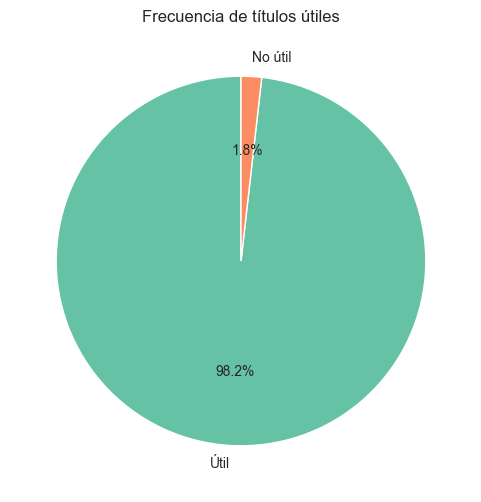

In [99]:
sizes = [
    df["useful_title"].sum(),
    len(df) - df["useful_title"].sum()
]
labels = ["Útil", "No útil"]
colors = ["#66c2a5","#fc8d62"]

plt.figure(figsize=(6,6))
plt.pie(sizes, labels=labels, autopct="%1.1f%%", startangle=90, colors=colors)
plt.title("Frecuencia de títulos útiles")
plt.show()

### Paso 4.3: ¿Cuántas entidades nombradas (personas, lugares, fechas, organizaciones) hay por texto?

In [100]:
# Count entities per text
df["num_entities"] = df["entities"].apply(lambda x: len(x) if isinstance(x, list) else 0)

# Quick summary
print(df[["num_entities"]].describe())

       num_entities
count   5635.000000
mean      17.469033
std       21.988457
min        0.000000
25%        5.000000
50%       11.000000
75%       22.000000
max      335.000000


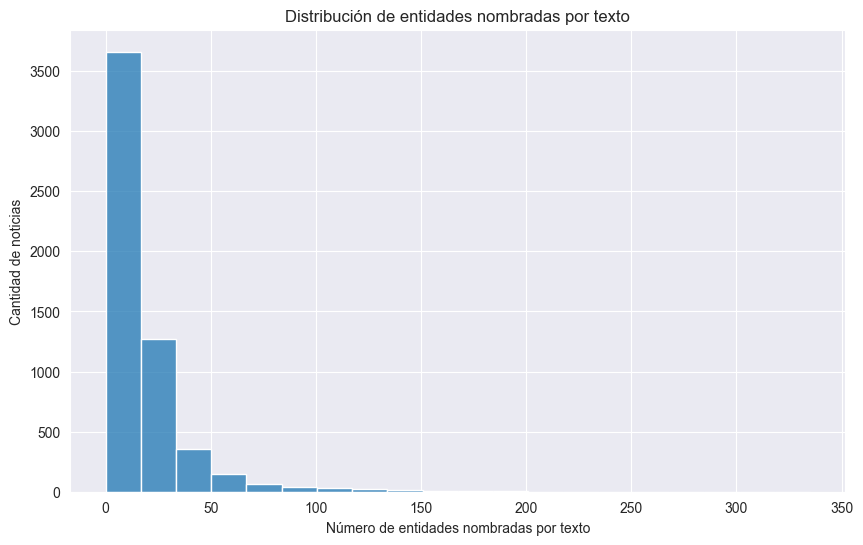

In [101]:
plt.figure(figsize=(10,6))
sns.histplot(df["num_entities"], bins=20, kde=False)
plt.xlabel("Número de entidades nombradas por texto")
plt.ylabel("Cantidad de noticias")
plt.title("Distribución de entidades nombradas por texto")
plt.show()

     country       category   count       mean        std   min   25%   50%  \
0   Colombia        Cultura  1118.0  21.906977  17.412946   0.0  10.0  19.0   
1   Colombia      Economica  1010.0   9.942574   8.538299   0.0   4.0   8.0   
2   Colombia  Internacional   556.0  18.140288  12.762915   0.0   8.0  16.0   
3   Colombia       Judicial   112.0   5.696429   4.553663   0.0   3.0   5.0   
4   Colombia       Politica   714.0  13.920168  12.302091   0.0   5.0  12.0   
5   Colombia          Salud   463.0   7.827214   7.269425   0.0   3.0   6.0   
6   Colombia      Seguridad     7.0  20.428571  11.296860  10.0  13.0  17.0   
7     México        Cultura   187.0   9.128342  15.802702   0.0   2.0   5.0   
8     México      Economica   200.0   6.785000   8.343070   0.0   1.0   4.0   
9     México  Internacional   449.0  51.204900  46.323618   0.0   9.0  46.0   
10    México       Judicial    96.0   5.895833   4.848177   0.0   3.0   5.0   
11    México       Politica   549.0  15.493625  14.8

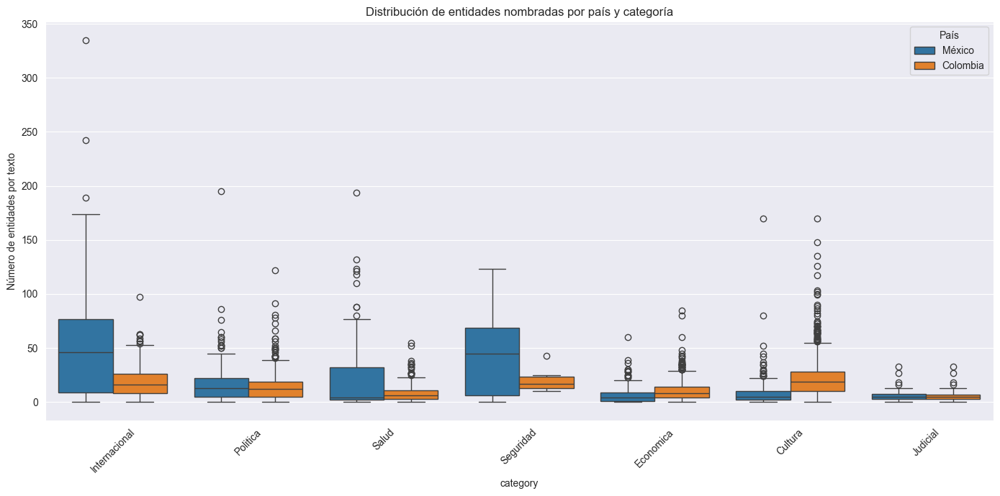

In [102]:
# Count entities per text (if not already done)
df["num_entities"] = df["entities"].apply(lambda x: len(x) if isinstance(x, list) else 0)

# Aggregate by country and category
agg_df = df.groupby(["country", "category"])["num_entities"].describe().reset_index()
print(agg_df[["country","category","count","mean","std","min","25%","50%","75%","max"]])

# Boxplot per country and category
plt.figure(figsize=(14,7))
sns.boxplot(data=df, x="category", y="num_entities", hue="country")
plt.xticks(rotation=45)
plt.ylabel("Número de entidades por texto")
plt.title("Distribución de entidades nombradas por país y categoría")
plt.legend(title="País")
plt.tight_layout()
plt.show()

### Paso 4.4: ¿Qué tipos de entidades predominan (PERSON, LOC, ORG, DATE, EVENT)?

  entity_type  entity_text
3         PER        51115
0         LOC        24926
1        MISC        11774
2         ORG        10623


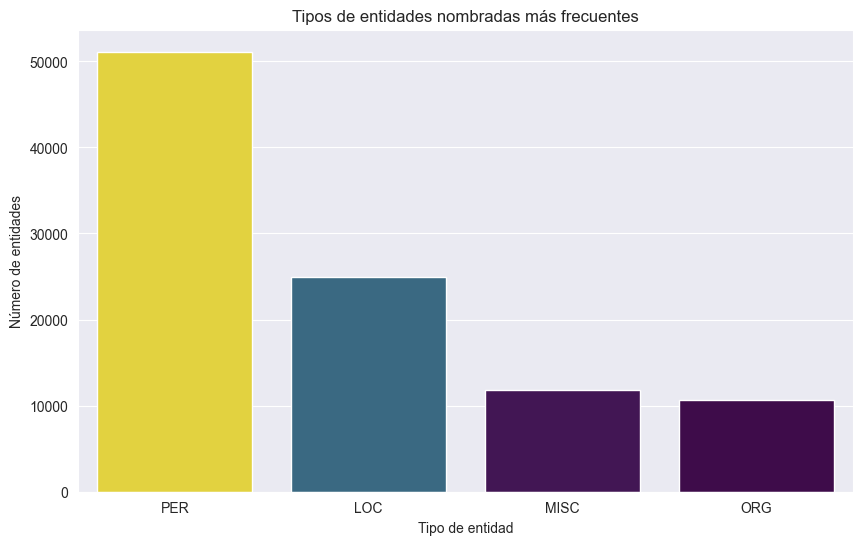

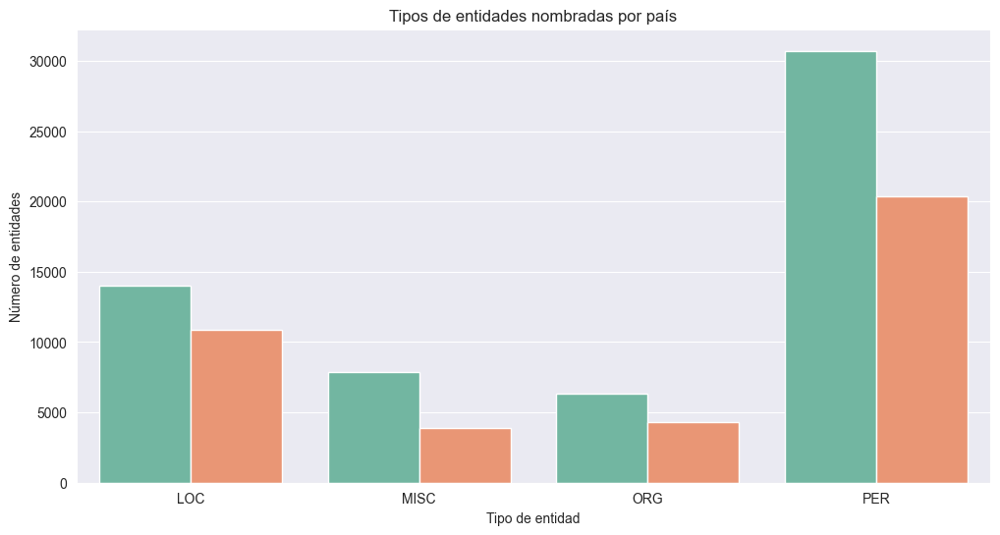

In [104]:
# Ensure 'entities' column has format [(text, type), ...]
df_entities = df.explode("entities").dropna(subset=["entities"])
df_entities["entity_text"] = df_entities["entities"].apply(lambda x: x[0] if isinstance(x, tuple) else None)
df_entities["entity_type"] = df_entities["entities"].apply(lambda x: x[1] if isinstance(x, tuple) else None)

# Count occurrences per entity type (overall)
entity_counts = df_entities.groupby("entity_type")["entity_text"].count().reset_index()
entity_counts = entity_counts.sort_values(by="entity_text", ascending=False)
print(entity_counts)

# Plot overall
plt.figure(figsize=(10,6))
sns.barplot(data=entity_counts, x="entity_type", y="entity_text", hue="entity_text", palette="viridis", legend=False)
plt.ylabel("Número de entidades")
plt.xlabel("Tipo de entidad")
plt.title("Tipos de entidades nombradas más frecuentes")
plt.show()

# Optional: By country
entity_counts_country = df_entities.groupby(["country","entity_type"])["entity_text"].count().reset_index()
plt.figure(figsize=(12,6))
sns.barplot(data=entity_counts_country, x="entity_type", y="entity_text", hue="country", palette="Set2", legend=False)
plt.ylabel("Número de entidades")
plt.xlabel("Tipo de entidad")
plt.title("Tipos de entidades nombradas por país")
plt.show()

### Paso 4.5: ¿Qué porcentaje de oraciones contiene información factual que podría servir como respuesta?

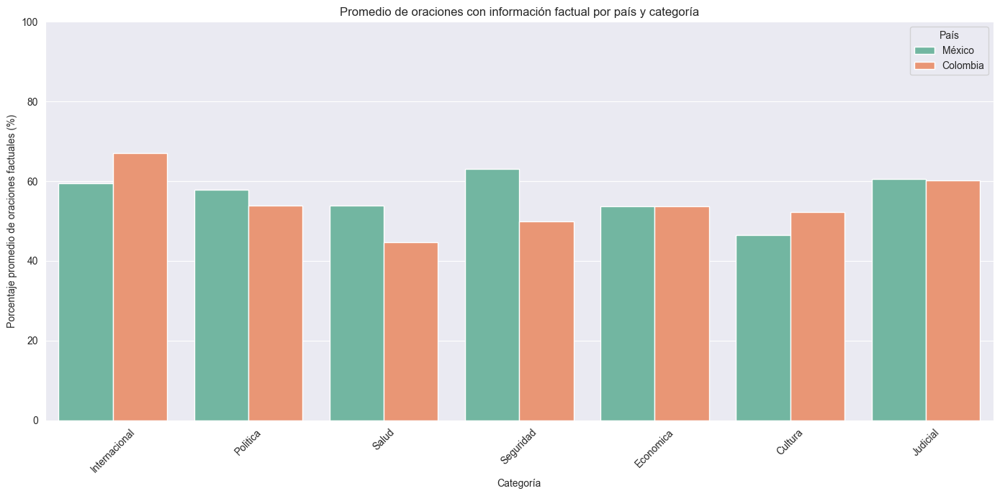

In [112]:
# Function to check if a sentence is factual
def is_factual(sentence, entities=[]):
    """
    Simple heuristic:
    - A sentence is factual if it contains a named entity or a number/date
    """
    if not sentence:
        return False
    for ent in entities:
        if isinstance(ent, tuple) and ent[0] in sentence:
            return True
    if any(char.isdigit() for char in sentence):
        return True
    return False

# Prepare a DataFrame to store results
rows = []

for country in df["country"].unique():
    for category in df["category"].unique():
        subset = df[(df["country"] == country) & (df["category"] == category)]
        percentages = []
        for _, row in subset.iterrows():
            sentences = row.get("content_sentence_tokenization", [])
            entities = row.get("entities", [])
            if not isinstance(sentences, list) or not sentences:
                continue
            factual = [s for s in sentences if is_factual(s, entities)]
            percentages.append(len(factual)/len(sentences))
        if percentages:
            rows.append({
                "country": country,
                "category": category,
                "factual_percentage": sum(percentages)/len(percentages) * 100
            })

plot_df = pd.DataFrame(rows)

# Plot with Seaborn using standard deviation as confidence interval
plt.figure(figsize=(14,7))
sns.barplot(
    data=plot_df,
    x="category",
    y="factual_percentage",
    hue="country",
    errorbar='sd',
    palette="Set2"
)
plt.ylabel("Porcentaje promedio de oraciones factuales (%)")
plt.xlabel("Categoría")
plt.title("Promedio de oraciones con información factual por país y categoría")
plt.ylim(0,100)
plt.xticks(rotation=45)
plt.legend(title="País")
plt.tight_layout()
plt.show()


In [113]:
# Overall average factual percentage across all texts
overall_avg = plot_df["factual_percentage"].mean()
print(f"Porcentaje promedio de oraciones factuales en todos los textos: {overall_avg:.2f}%")

Porcentaje promedio de oraciones factuales en todos los textos: 55.48%
